# PHASE 1: DATA WRANGLING

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.decomposition import PCA

# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/FYP/FYP - 1/DS Project/cleaned_dataset_unchanged.csv')

df.describe()

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
count,10372.000000,10372.000000,1.037200e+04,1.037200e+04,1.037200e+04,1.037200e+04,10372.000000,10372.000000
mean,304.000482,191916.501771,1.618318e+05,3.359385e+04,3.759910e+05,4.839218e+05,0.500000,0.000193
std,195.039029,210739.080847,2.190941e+05,1.157398e+05,7.995562e+05,8.648026e+05,0.500024,0.013886
min,1.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,159.000000,23627.065000,4.440750e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000
50%,282.000000,117822.255000,5.873753e+04,0.000000e+00,0.000000e+00,3.362944e+04,0.500000,0.000000
75%,407.000000,284953.407500,2.387175e+05,0.000000e+00,3.385975e+05,5.975642e+05,1.000000,0.000000
max,743.000000,906270.630000,1.161997e+06,1.088511e+06,4.983824e+06,5.065882e+06,1.000000,1.000000


#1 - Cleaning

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6362620 entries, 0 to 6362619
Data columns (total 11 columns):
 #   Column          Dtype  
---  ------          -----  
 0   step            int64  
 1   type            object 
 2   amount          float64
 3   nameOrig        object 
 4   oldbalanceOrg   float64
 5   newbalanceOrig  float64
 6   nameDest        object 
 7   oldbalanceDest  float64
 8   newbalanceDest  float64
 9   isFraud         int64  
 10  isFlaggedFraud  int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 534.0+ MB


## Checking for missing values and duplicates

In [ ]:
# Checking for missing values
print(df.isnull().sum())

step              0
type              0
amount            0
nameOrig          0
oldbalanceOrg     0
newbalanceOrig    0
nameDest          0
oldbalanceDest    0
newbalanceDest    0
isFraud           0
isFlaggedFraud    0
dtype: int64


In [ ]:
# Checking for duplicates
duplicates = df[df.duplicated()]

if duplicates.shape[0] == 0:
    print("Duplicate Check: No duplicate rows found.")
else:
    print(f"Duplicate Check: {duplicates.shape[0]} duplicate rows found.")

Duplicate Check: No duplicate rows found.


## Dropping outlier rows (0.1-0.9 kept)

In [ ]:
# Define a function to remove outliers using IQR - Inter Quartile Range
def remove_outliers_iqr(df, columns):
    for column in columns:
        Q1 = df[column].quantile(0.1)
        Q3 = df[column].quantile(0.9)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return df

# Numerical columns for which we want to remove outliers
numerical_columns = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Removing outliers
df_cleaned = remove_outliers_iqr(df, numerical_columns)

# Checking the shape of the cleaned dataset
print("Original dataset shape:", df.shape)
print("Cleaned dataset shape:", df_cleaned.shape)

df = df_cleaned

Original dataset shape: (6362620, 11)
Cleaned dataset shape: (5238012, 11)


## Handling Class Imbalance

In [ ]:
import pandas as pd
import numpy as np

# Select all rows with isFraud == True
fraudulent_rows = df[df['isFraud'] == True]

# Undersampling non-fraudulent rows
non_fraud_needed = len(fraudulent_rows)

# Select non-fraudulent rows randomly to meet the required count
non_fraudulent_rows = df[df['isFraud'] == False].sample(n=non_fraud_needed, random_state=42)

# Concatenate the two DataFrames to get the final selection
selected_rows = pd.concat([fraudulent_rows, non_fraudulent_rows])

# Reset the index
selected_rows.reset_index(drop=True, inplace=True)

In [ ]:
df = selected_rows.sample(frac=1.0, random_state=42)

In [ ]:
df.reset_index(drop=True)

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,608,PAYMENT,4775.59,C60093576,205278.00,200502.41,M1756426094,0.00,0.00,0,0
1,149,TRANSFER,661558.27,C644461702,661558.27,0.00,C1700734681,0.00,0.00,1,0
2,84,TRANSFER,152331.26,C397720555,152331.26,0.00,C1006668962,0.00,0.00,1,0
3,667,TRANSFER,71554.74,C118393699,71554.74,0.00,C1077131612,0.00,0.00,1,0
4,719,CASH_OUT,119306.06,C1199258183,119306.06,0.00,C136557058,4040.44,123346.50,1,0
...,...,...,...,...,...,...,...,...,...,...,...
10367,355,CASH_OUT,201609.43,C1538872419,100719.00,0.00,C1021781480,433899.68,635509.12,0,0
10368,165,PAYMENT,7197.79,C12949149,248.41,0.00,M1496540464,0.00,0.00,0,0
10369,183,CASH_OUT,242460.56,C2056194555,0.00,0.00,C699459605,360923.83,603384.39,0,0
10370,109,TRANSFER,252417.45,C1220229602,252417.45,0.00,C1660826618,0.00,0.00,1,0


In [ ]:
df.to_csv("/content/drive/MyDrive/FYP/FYP - 1/DS Project/cleaned_dataset_unchanged.csv", index=False)

## Transformation

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10372 entries, 7516 to 7270
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   step            10372 non-null  int64  
 1   type            10372 non-null  object 
 2   amount          10372 non-null  float64
 3   nameOrig        10372 non-null  object 
 4   oldbalanceOrg   10372 non-null  float64
 5   newbalanceOrig  10372 non-null  float64
 6   nameDest        10372 non-null  object 
 7   oldbalanceDest  10372 non-null  float64
 8   newbalanceDest  10372 non-null  float64
 9   isFraud         10372 non-null  int64  
 10  isFlaggedFraud  10372 non-null  int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 972.4+ KB


In [ ]:
df_for_visualization = df.copy()

Text(0.5, 1.0, 'Distribution of Transaction Types')

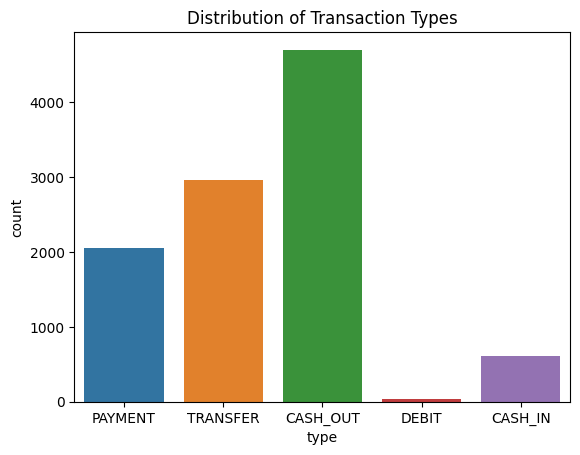

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

#Unique values for type column
sns.countplot(data=df_for_visualization, x='type')
plt.title("Distribution of Transaction Types")

In [4]:
#One hot encoding type column
df = pd.get_dummies(df, columns=['type'], drop_first=True)

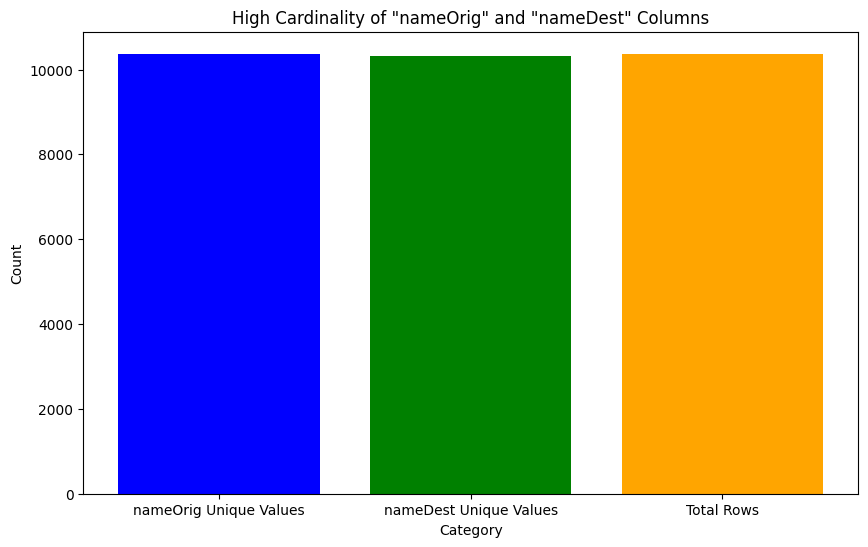

In [5]:
import matplotlib.pyplot as plt

# Calculate the unique value count for both columns and the total number of rows
unique_count_nameOrig = df['nameOrig'].nunique()
unique_count_nameDest = df['nameDest'].nunique()
total_rows = df.shape[0]

# Create a bar plot to visualize the unique value counts for both columns
plt.figure(figsize=(10, 6))
plt.bar(['nameOrig Unique Values', 'nameDest Unique Values', 'Total Rows'],
        [unique_count_nameOrig, unique_count_nameDest, total_rows],
        color=['blue', 'green', 'orange'])
plt.title('High Cardinality of "nameOrig" and "nameDest" Columns')
plt.xlabel('Category')
plt.ylabel('Count')
plt.show()

In [6]:
df.to_csv("/content/drive/MyDrive/FYP/FYP - 1/DS Project/cleaned_dataset_unchanged_typeEncoded.csv", index=False)

In [ ]:
import category_encoders as ce

# Create a hasher object
hasher = ce.HashingEncoder(n_components=100)

# Fit and transform the nameOrig data
transformed_namesOrig = hasher.fit_transform(df['nameOrig'])

In [ ]:
# Create a hasher object
hasher = ce.HashingEncoder(n_components=100)

# Fit and transform the nameDest data
transformed_namesDest = hasher.fit_transform(df['nameDest'])

## Dimentionality Reduction

In [ ]:
# Apply PCA to the hashed nameOrig
n_components = 10
pca = PCA(n_components=n_components)
pca_result = pca.fit_transform(transformed_namesOrig)
pca_result
# Create a new DataFrame with reduced dimensionality features and meaningful column names
column_names = [f'PCA_{i}' for i in range(1, n_components + 1)]
df_reduced_names_Orig = pd.DataFrame(data=pca_result, columns=column_names)

In [ ]:
# Apply PCA to the hashed nameDest
n_components = 10
pca = PCA(n_components=n_components)
pca_result = pca.fit_transform(transformed_namesDest)
pca_result
# Create a new DataFrame with reduced dimensionality features and meaningful column names
column_names = [f'PCA_{i+10}' for i in range(1, n_components + 1)]
df_reduced_namesDest = pd.DataFrame(data=pca_result, columns=column_names)

In [ ]:
# Concatenate the original DataFrame with the transformed data
df = pd.concat([df, df_reduced_names_Orig, df_reduced_namesDest], axis=1)

#Dropping nameOrig and nameDest columns
df.drop(columns=['nameOrig', 'nameDest'], inplace=True)

In [ ]:
# Standardize the data
scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

In [ ]:
df_scaled.reset_index()

,index,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud,type_CASH_OUT,...,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17,PCA_18,PCA_19,PCA_20
0,0,1.558735,-0.888065,0.198309,1.442172,-0.470272,-0.559602,-1.0,-0.013888,-0.910646,...,1.526296,-1.269600,-0.809452,1.187682,-2.380439,1.417895,1.386426,0.763871,0.335322,0.534800
1,1,-0.794754,2.228654,2.280986,-0.290267,-0.470272,-0.559602,1.0,-0.013888,-0.910646,...,0.060346,-0.356268,-0.701412,-0.203043,0.262113,0.624011,-1.364744,1.311201,-0.440138,-1.214210
2,2,-1.128036,-0.187849,-0.043365,-0.290267,-0.470272,-0.559602,1.0,-0.013888,-0.910646,...,0.420820,0.233733,-0.328308,-0.117120,0.224494,-0.577604,-0.441464,-0.562324,-0.420822,0.151654
3,3,1.861253,-0.571169,-0.412067,-0.290267,-0.470272,-0.559602,1.0,-0.013888,-0.910646,...,0.028947,-0.703486,0.220668,0.975173,0.073909,0.944918,-0.174824,0.310142,-1.030020,-2.094145
4,4,2.127879,-0.344568,-0.194108,-0.290267,-0.465219,-0.416965,1.0,-0.013888,1.098121,...,0.148732,-0.039046,0.222071,-0.226776,0.376439,-0.131757,0.025059,0.136663,0.612057,-0.053762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10367,10367,0.261496,0.045997,-0.278948,-0.290267,0.072429,0.175294,-1.0,-0.013888,1.098121,...,-0.146701,0.116124,0.276484,1.019170,0.448667,-0.028974,-1.251837,-0.108854,-1.221241,-0.907948
10368,10368,-0.712715,-0.876570,-0.737543,-0.290267,-0.470272,-0.559602,-1.0,-0.013888,-0.910646,...,0.357682,0.223485,-0.142726,-0.075087,-0.083529,0.002632,0.320626,0.539101,-0.279465,-0.650893
10369,10369,-0.620421,0.239853,-0.738677,-0.290267,-0.018845,0.138145,-1.0,-0.013888,1.098121,...,0.505205,-0.232493,-0.173146,-0.121907,0.978631,0.184495,-1.484419,1.507264,1.285591,1.486562
10370,10370,-0.999851,0.287103,0.413475,-0.290267,-0.470272,-0.559602,1.0,-0.013888,-0.910646,...,1.526296,-1.269600,-0.809452,1.187682,-2.380439,1.417895,1.386426,0.763871,0.335322,0.534800


## Data Validation

Data Validation Summary:
Accuracy: No accuracy issues found.
Consistency Issue: Data consistency problem found.
Completeness: Data is complete.
Duplicate Check: No duplicate rows found.
All columns have appropriate data types.
Target variable 'isFraud' is present.


        Validation Check                                    Status
0               Accuracy                 No accuracy issues found.
1            Consistency           Data consistency problem found.
2           Completeness                         Data is complete.
3             Duplicates                  No duplicate rows found.
4             Data Types  All columns have appropriate data types.
5  Categorical Variables           No categorical variables found.
6        Target Variable     Target variable 'isFraud' is present.


<class 'pandas.core.frame.DataFrame'>
Int64Index: 10372 entries, 7516 to 7270
Data columns (total 32 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  --

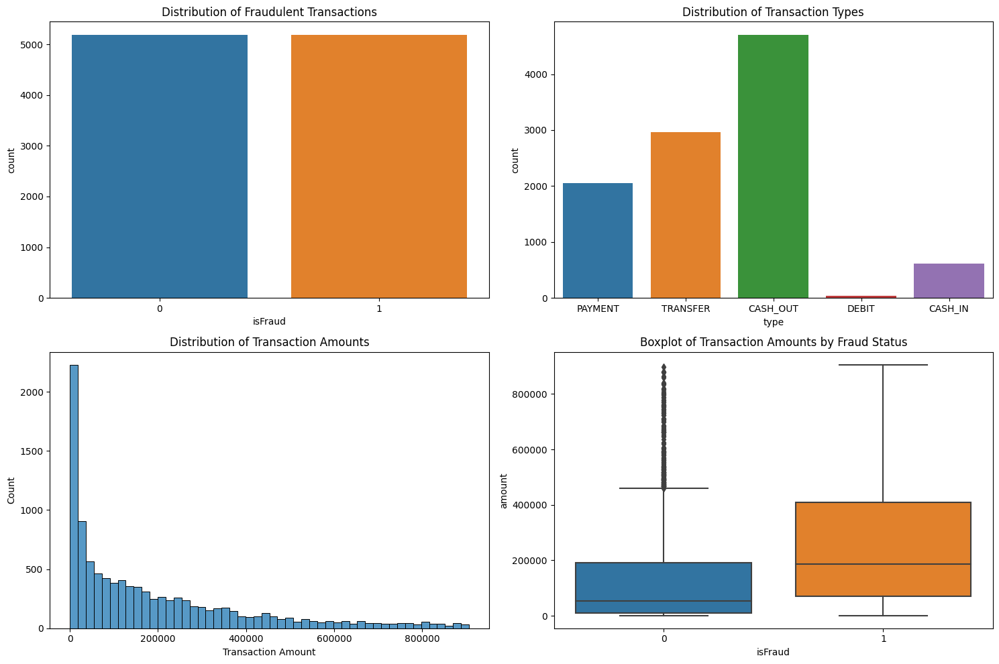

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Check for missing values
missing_values = df.isnull().sum()

# Check for duplicates
duplicates = df[df.duplicated()]

# Perform domain-specific validation
negative_amounts = df[df['amount'] < 0]
inconsistent_balance = df[df['oldbalanceOrg'] > df['newbalanceOrig']]

# Define conditions for accuracy and consistency checks
accuracy_condition = (df['isFraud'] == 0) & (df['amount'] < 0)

# Check if 'oldbalanceOrg' is greater than 'newbalanceOrig' for non-fraudulent transactions
consistency_condition = (df['isFraud'] == 0) & (df['oldbalanceOrg'] > df['newbalanceOrig'])

# Calculate accuracy and consistency flags
accuracy_flag = accuracy_condition.any()
consistency_flag = consistency_condition.any()

# Getting Data validation summary
print("Data Validation Summary:")
if accuracy_flag:
    print("Accuracy Issue: Inaccurate data found.")
else:
    print("Accuracy: No accuracy issues found.")

if consistency_flag:
    print("Consistency Issue: Data consistency problem found.")
else:
    print("Consistency: No consistency issues found.")

if missing_values.sum() == 0:
    print("Completeness: Data is complete.")
else:
    print("Completeness: Data has missing values.")

if duplicates.shape[0] == 0:
    print("Duplicate Check: No duplicate rows found.")
else:
    print(f"Duplicate Check: {duplicates.shape[0]} duplicate rows found.")

# Check Data Types
if not df.select_dtypes(include=['number']).empty:
    print("All columns have appropriate data types.")
else:
    print("Some columns have inappropriate data types. You may need to convert or encode them.")

categorical_columns = df.select_dtypes(include=['object', 'uint8', 'category']).columns

# Check Target Variable (isFraud)
if 'isFraud' in df.columns:
    print("Target variable 'isFraud' is present.")
else:
    print("Target variable 'isFraud' is missing. You need a target variable for supervised learning.")

# Data Validation Summary
data_validation_summary = {
    'Validation Check': ['Accuracy', 'Consistency', 'Completeness', 'Duplicates', 'Data Types', 'Categorical Variables', 'Target Variable'],
    'Status': [
        'Inaccurate data found.' if accuracy_flag else 'No accuracy issues found.',
        'Data consistency problem found.' if consistency_flag else 'No consistency issues found.',
        'Data has missing values.' if missing_values.sum() > 0 else 'Data is complete.',
        f'{duplicates.shape[0]} duplicate rows found.' if duplicates.shape[0] > 0 else 'No duplicate rows found.',
        'Some columns have inappropriate data types. You may need to convert or encode them.' if df.select_dtypes(include=['number']).empty else 'All columns have appropriate data types.',
        'Categorical variables found. You may need to encode them (e.g., one-hot encoding).' if categorical_columns.empty else 'No categorical variables found.',
        "Target variable 'isFraud' is missing. You need a target variable for supervised learning." if 'isFraud' not in df.columns else "Target variable 'isFraud' is present."
    ]
}

# Create DataFrame
df_summary = pd.DataFrame(data_validation_summary)

# Print DataFrame
print(f"\n\n{df_summary}\n\n")

df.info()

# Visualizations
plt.figure(figsize=(15, 10))

# Distribution of Fraudulent Transactions
plt.subplot(2, 2, 1)
sns.countplot(data=df, x='isFraud')
plt.title("Distribution of Fraudulent Transactions")

# Distribution of Transaction Types
plt.subplot(2, 2, 2)
sns.countplot(data=df_for_visualization, x='type')
plt.title("Distribution of Transaction Types")

# Distribution of Transaction Amounts
plt.subplot(2, 2, 3)
sns.histplot(data=df, x='amount', bins=50)
plt.title("Distribution of Transaction Amounts")
plt.xlabel("Transaction Amount")

# Boxplot of Transaction Amounts by Fraud Status
plt.subplot(2, 2, 4)
sns.boxplot(data=df, x='isFraud', y='amount')
plt.title("Boxplot of Transaction Amounts by Fraud Status")

plt.tight_layout()
plt.show()

In [ ]:
df.to_csv("/content/drive/MyDrive/FYP/FYP - 1/DS Project/cleaned_dataset.csv", index=False)

# PHASE 2: VISUALISATION

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv("cleaned_dataset.csv")

In [3]:
from scipy.stats import skew

skewness = skew(df['PCA_1'])
print(f"Skewness: {skewness}")

Skewness: 5.828972694230167


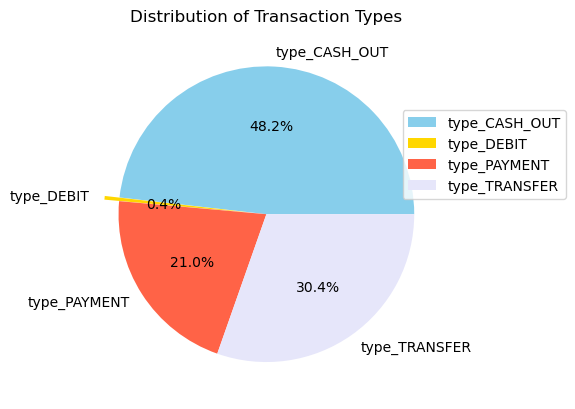

In [4]:
# Pie Plot to show distribution of types of transactions
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()

plt.pie(transaction_type_counts, labels=['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER'], colors=['skyblue', 'gold', 'tomato', 'Lavender'],
        explode=(0, 0.1, 0, 0), autopct='%1.1f%%', startangle=0)
plt.legend(loc='upper left', bbox_to_anchor=(0.85, 0.8))
plt.title('Distribution of Transaction Types')
plt.show()

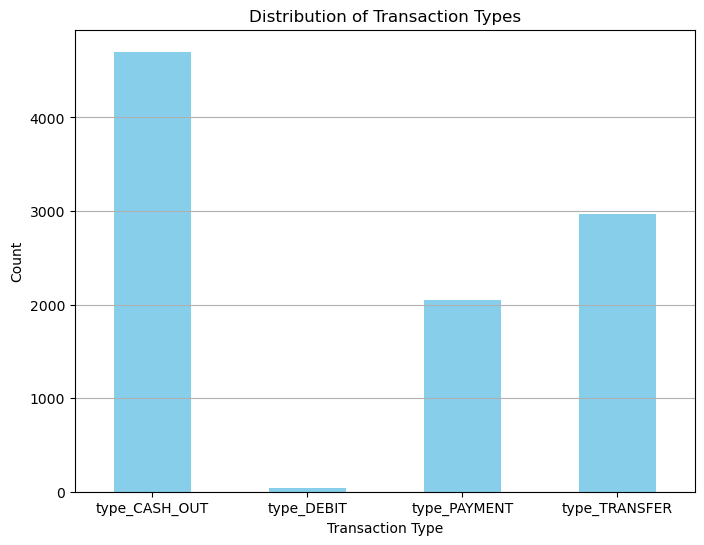

In [5]:
# Count the occurrences of each transaction type
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()
# Create the bar chart
plt.figure(figsize=(8, 6))
transaction_type_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Transaction Types')
plt.xlabel('Transaction Type')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y')
plt.show()

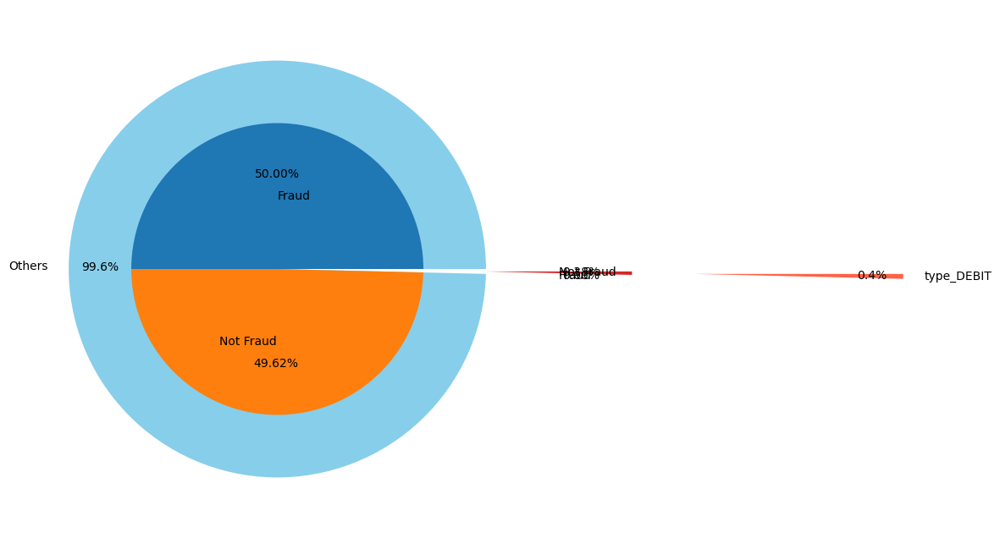

In [6]:
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']
plt.figure(figsize=(8,8))
explode = (0, 2)
transaction = 'type_DEBIT'
plt.pie(df[transaction].value_counts(), labels=['Others', transaction],autopct='%1.1f%%', startangle=0, explode=explode , pctdistance=0.85, colors=['skyblue', 'tomato'])
fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 0)])

ins=plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
            labels=labels,
      autopct="%0.2f%%",radius=0.7,pctdistance=0.65,labeldistance=0.5,startangle=0, explode=(0,0, 1, 1))
fig = plt.gcf()
plt.show()

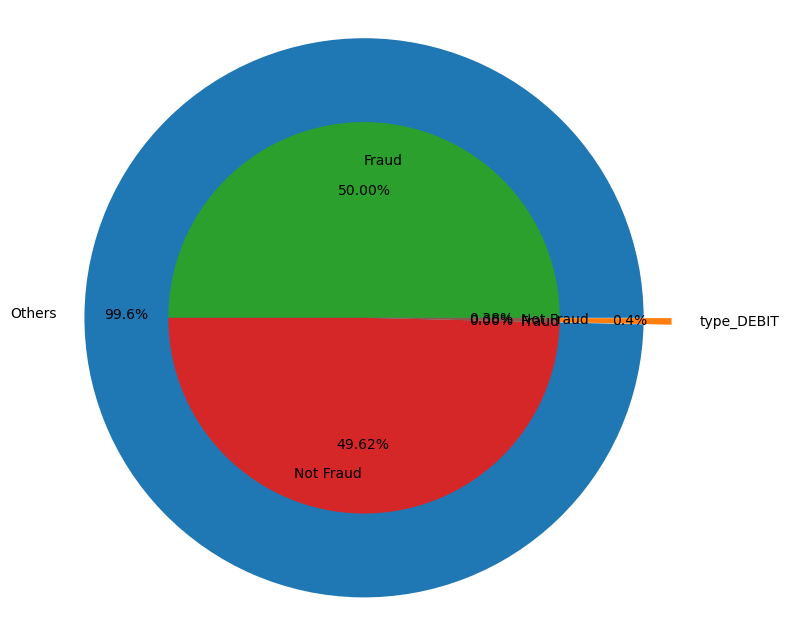

In [7]:
import matplotlib.pyplot as plt

transaction = 'type_DEBIT'

# Define the labels
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']

# Create a figure with a specified size
plt.figure(figsize=(8, 8))

# Define the explode values (emphasizing the second section)
explode = (0, 0.1)

# Generate the first pie chart
plt.pie(df[transaction].value_counts(), labels=['Others', transaction], autopct='%1.1f%%', startangle=0, pctdistance=0.85, explode=explode)

# Calculate counts
fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 0)])

# Generate the second pie chart (inside the first)
ins = plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
              labels=labels,
              autopct="%0.2f%%",
              radius=0.7,
              pctdistance=0.65,
              labeldistance=0.8,
              startangle=0)

# Set the aspect ratio to ensure the pie chart is circular
plt.axis('equal')

# Get the current figure
fig = plt.gcf()

# Show the figure
plt.show()


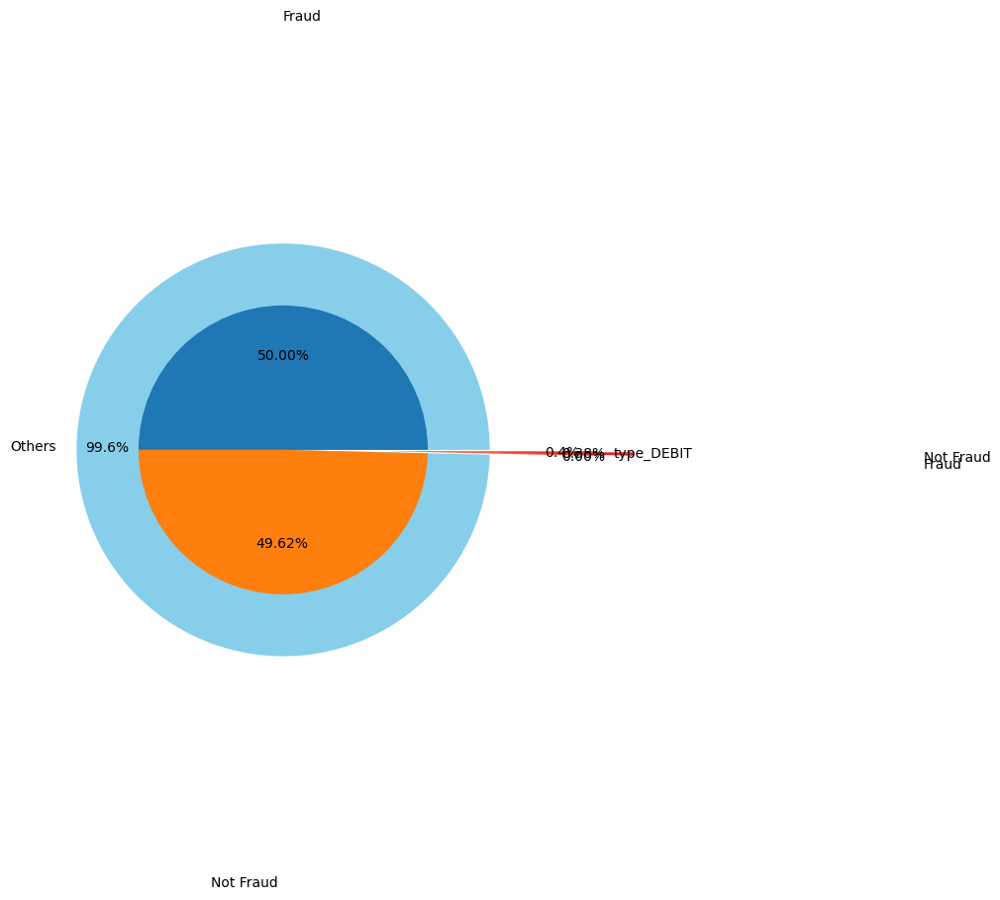

In [8]:
import matplotlib.pyplot as plt

transaction = 'type_DEBIT'

# Define the labels
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']

# Create a figure with a specified size
plt.figure(figsize=(8, 8))

# Define the explode values to emphasize the 'type_DEBIT' section
explode = (0, 0.5)  # Adjust the second value to control the explosion

# Generate the pie chart for 'type_DEBIT'
plt.pie(df[transaction].value_counts(), labels=['Others', transaction], autopct='%1.1f%%', startangle=0, explode=explode, pctdistance=0.85, colors=['skyblue', 'tomato'])

# Calculate counts
fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 0)])

# Generate the second pie chart (inside the first)
ins = plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
              labels=labels,
              autopct="%0.2f%%",
              radius=0.7,
              pctdistance=0.65,
              labeldistance=3,  # Adjust this value for label positioning
              startangle=0,
              explode=(0, 0, 1, 1))

# Set the aspect ratio to ensure the pie chart is circular
plt.axis('equal')

# Get the current figure
fig = plt.gcf()

# Show the figure
plt.show()


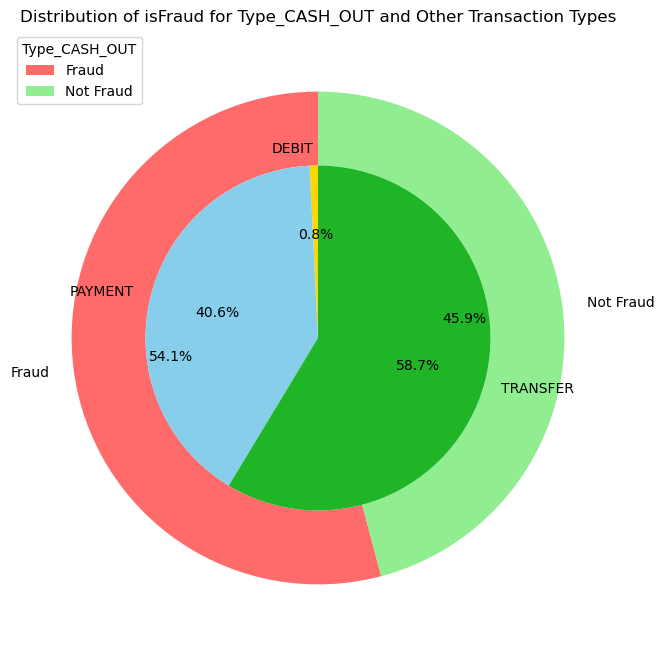

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter data for type_CASH_OUT transactions
type_cash_out = df[df['type_CASH_OUT'] == 1]

# Calculate the distribution of 'isFraud' for type_CASH_OUT transactions
fraud_counts = type_cash_out[type_cash_out['isFraud'] == 1].shape[0]
non_fraud_counts = type_cash_out[type_cash_out['isFraud'] == 0].shape[0]

# Create the nested pie chart
fig, ax = plt.subplots(figsize=(8, 8))

# Inner pie chart for 'isFraud' and 'not isFraud' distribution
inner_labels = ['Fraud', 'Not Fraud']
inner_sizes = [fraud_counts, non_fraud_counts]
inner_colors = ['#FF6B6B', '#90EE90']
ax.pie(inner_sizes, labels=inner_labels, autopct='%1.1f%%', startangle=90, colors=inner_colors)

# Set a circle in the center to create a donut chart
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Outer pie chart for the distribution of 'type' other than 'CASH_OUT'
outer_labels = ['DEBIT', 'PAYMENT', 'TRANSFER']
outer_sizes = [
    df[df['type_DEBIT'] == 1].shape[0],
    df[df['type_PAYMENT'] == 1].shape[0],
    df[df['type_TRANSFER'] == 1].shape[0]
]
outer_colors = ['#FFD700', '#87CEEB', '#1fb527']
ax.pie(outer_sizes, labels=outer_labels, autopct='%1.1f%%', startangle=90, radius=0.7, colors=outer_colors)

# Add a legend
ax.legend(inner_labels, title='Type_CASH_OUT', loc='upper left')

# Set the title
plt.title('Distribution of isFraud for Type_CASH_OUT and Other Transaction Types')

plt.show()


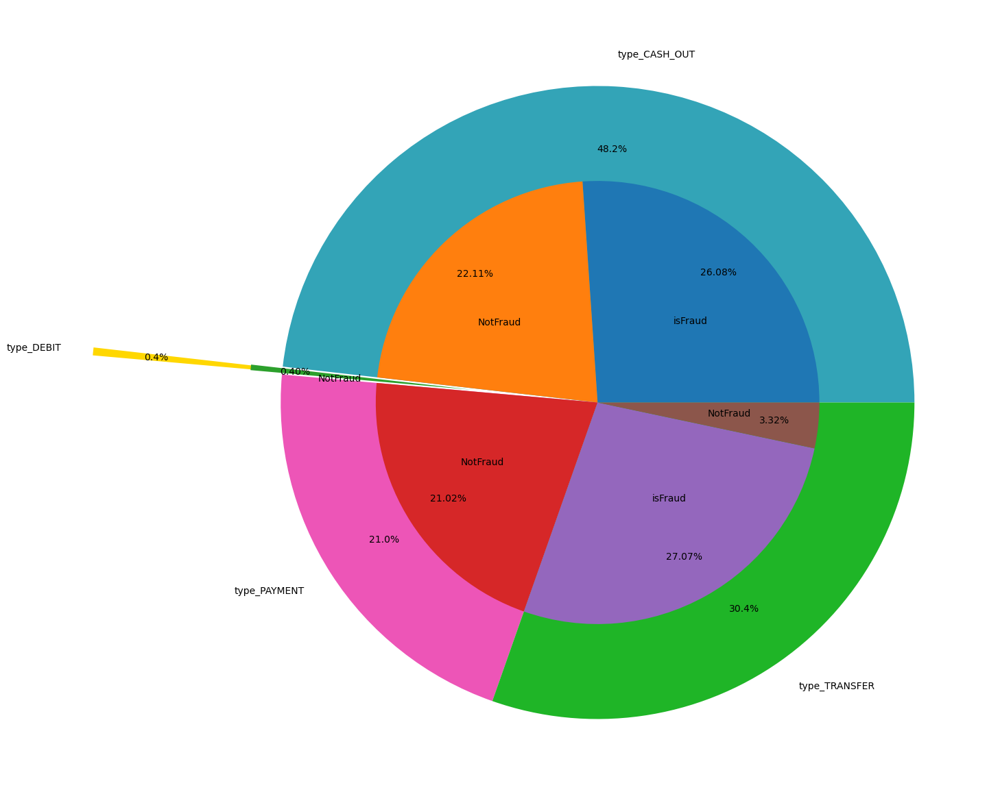

In [11]:
plt.figure(figsize=(15,15))
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()

#outside donut
out=plt.pie(transaction_type_counts, labels=['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER'], colors=['#33a4b7', 'gold', '#ed55b7', '#1fb527'],
        explode=(0, 0.6, 0, 0), autopct='%1.1f%%', startangle=0, pctdistance=0.80)

#inside donut
ins=plt.pie(np.concatenate((df[df.type_CASH_OUT==1].isFraud.value_counts().values,
                            df[df.type_DEBIT==1].isFraud.value_counts().values,
                            df[df.type_PAYMENT==1].isFraud.value_counts().values,
                            df[df.type_TRANSFER==1].isFraud.value_counts().values)),
            labels=['isFraud', 'NotFraud', 'NotFraud', 'NotFraud', 'isFraud', 'NotFraud'],
       autopct="%0.2f%%",radius=0.7,pctdistance=0.80,startangle=0, labeldistance=0.5, explode=(0,0,0.4,0,0,0))
hole = plt.Circle((0, 0), 0.4, color='white', linewidth=0)
fig = plt.gcf()
plt.show()
#plt.gcf().gca().add_artist(hole)

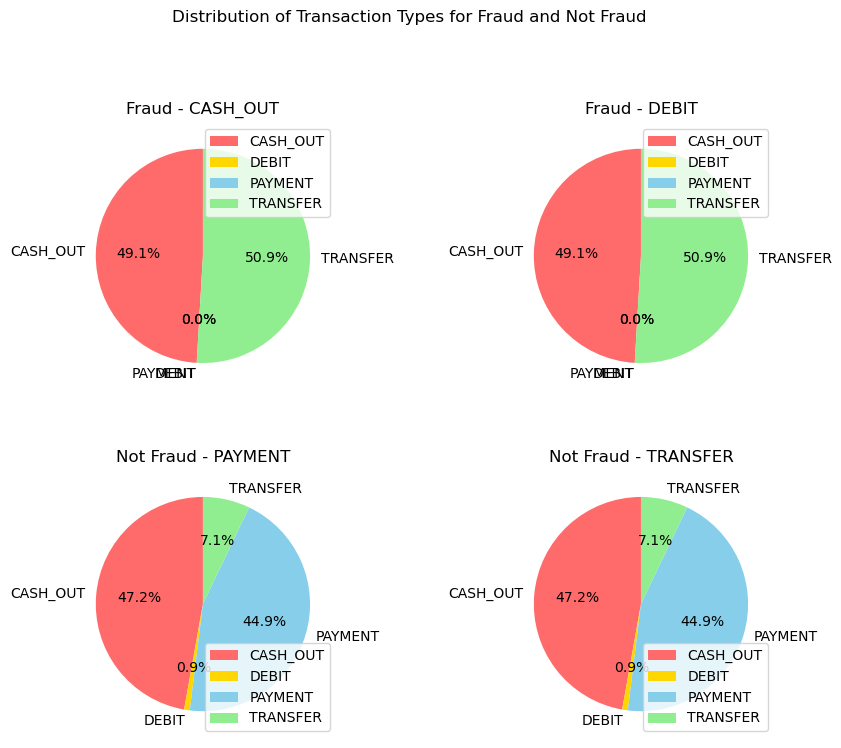

In [12]:
# Calculate the counts of each transaction type for fraud and not fraud
fraud_counts = df[df['isFraud'] == 1][['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()
non_fraud_counts = df[df['isFraud'] == 0][['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()

# Define labels for the pie charts
labels = ['CASH_OUT', 'DEBIT', 'PAYMENT', 'TRANSFER']

# Create subplots for four pie charts
fig, axes = plt.subplots(2, 2, figsize=(10, 8))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Pie chart for Fraud - CASH_OUT
axes[0, 0].pie(fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[0, 0].set_title('Fraud - CASH_OUT')

# Pie chart for Fraud - DEBIT
axes[0, 1].pie(fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[0, 1].set_title('Fraud - DEBIT')

# Pie chart for Not Fraud - PAYMENT
axes[1, 0].pie(non_fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[1, 0].set_title('Not Fraud - PAYMENT')

# Pie chart for Not Fraud - TRANSFER
axes[1, 1].pie(non_fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[1, 1].set_title('Not Fraud - TRANSFER')

# Add legends
for ax in axes.flatten():
    ax.legend(labels, loc='best')

# Display the subplots
plt.suptitle('Distribution of Transaction Types for Fraud and Not Fraud', y=1.02)
plt.show()

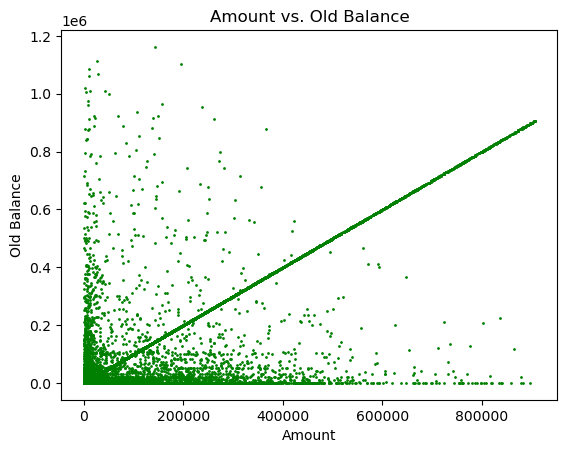

In [13]:
plt.scatter(df['amount'], df['oldbalanceOrg'], s=1, c='green')
plt.xlabel('Amount')
plt.ylabel('Old Balance')
plt.title('Amount vs. Old Balance')
plt.show()

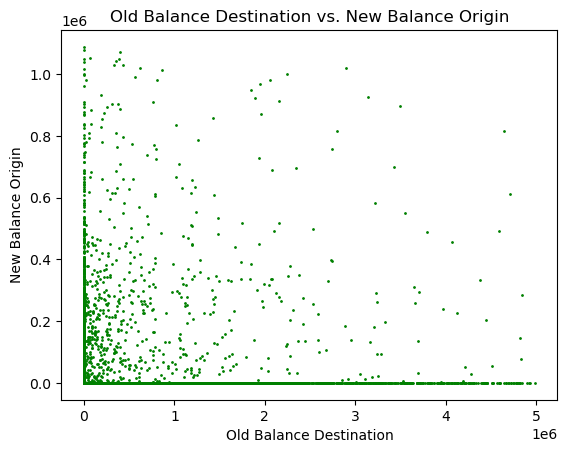

In [14]:
plt.scatter(df['oldbalanceDest'], df['newbalanceOrig'], s=1, c='green')
plt.xlabel('Old Balance Destination')
plt.ylabel('New Balance Origin')
plt.title('Old Balance Destination vs. New Balance Origin')
plt.show()

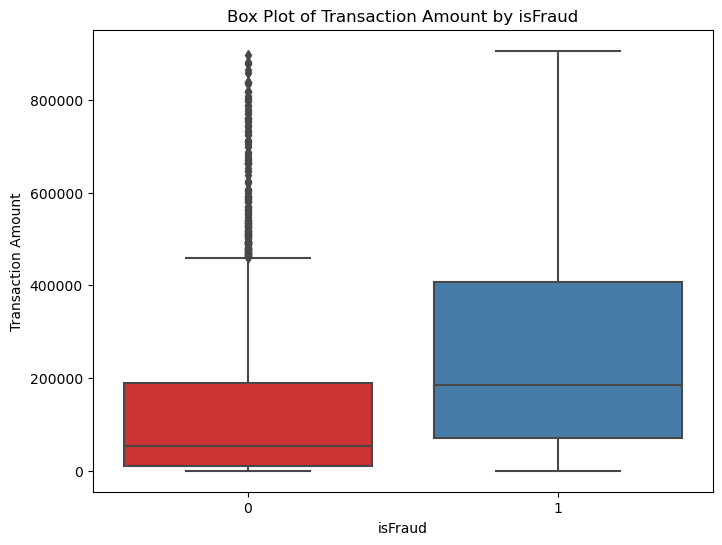

In [15]:
# Create a box plot to visualize the distribution of 'amount' for 'isFraud' levels
plt.figure(figsize=(8, 6))
sns.boxplot(x='isFraud', y='amount', data=df, palette='Set1')
plt.title('Box Plot of Transaction Amount by isFraud')
plt.xlabel('isFraud')
plt.ylabel('Transaction Amount')
plt.show()

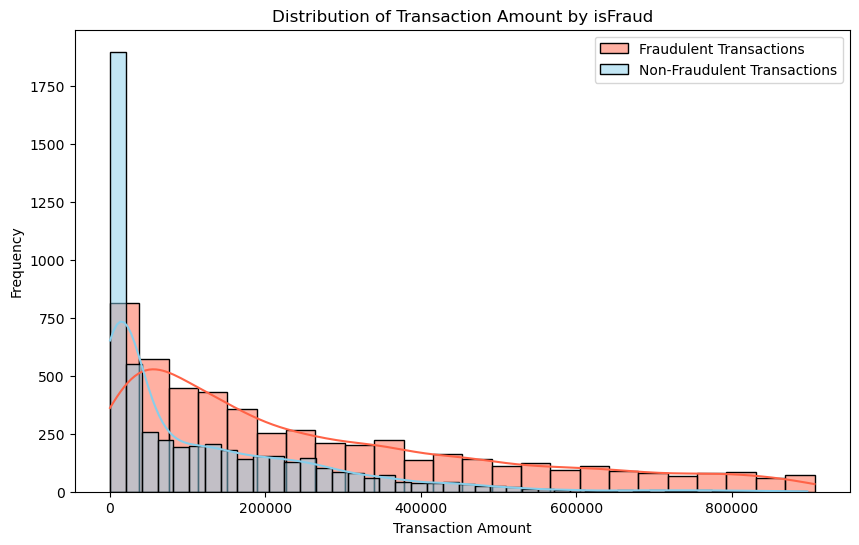

In [16]:
# Create separate data frames for 'isFraud' levels
fraudulent_transactions = df[df['isFraud'] == 1]
non_fraudulent_transactions = df[df['isFraud'] == 0]

# Set the figure size
plt.figure(figsize=(10, 6))

# Create histograms for 'amount' for fraudulent transactions (red)
sns.histplot(fraudulent_transactions['amount'], kde=True, color='tomato', label='Fraudulent Transactions')

# Create histograms for 'amount' for non-fraudulent transactions (blue)
sns.histplot(non_fraudulent_transactions['amount'], kde=True, color='skyblue', label='Non-Fraudulent Transactions')

# Set plot labels and title
plt.title('Distribution of Transaction Amount by isFraud')
plt.xlabel('Transaction Amount')
plt.ylabel('Frequency')

# Add a legend
plt.legend()

# Display the plot
plt.show()

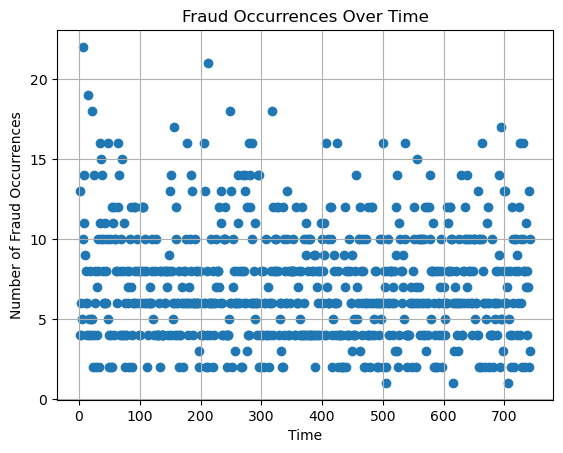

In [17]:
# Group the data by the 'step' and count the number of fraud occurrences in each time period
fraud_count = df[df['isFraud'] == 1].groupby('step').size()

# Create a line plot
plt.scatter(fraud_count.index, fraud_count.values, marker='o', linestyle='-')
plt.title('Fraud Occurrences Over Time')
plt.xlabel('Time')
plt.ylabel('Number of Fraud Occurrences')
plt.grid(True)
plt.show()


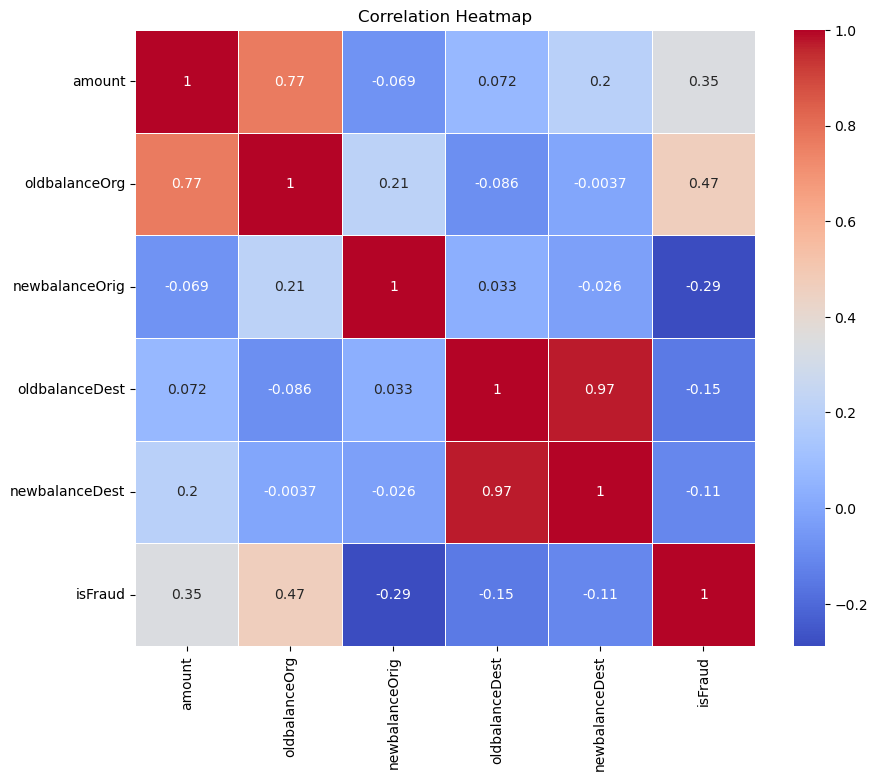

In [18]:
selected_features = df[['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest', 'isFraud']]

correlation_matrix = selected_features.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()


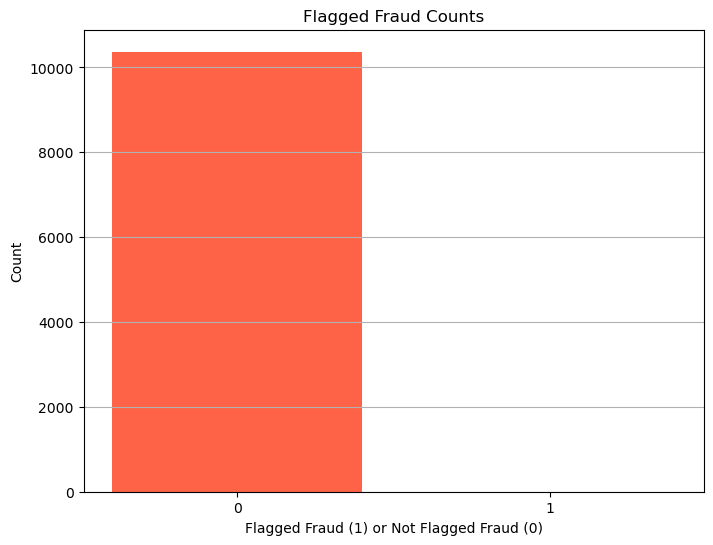

In [20]:
# Group the data by 'isFlaggedFraud' and calculate the count of flagged fraud
flagged_fraud_counts = df['isFlaggedFraud'].value_counts().reset_index()
flagged_fraud_counts.columns = ['isFlaggedFraud', 'Count']

plt.figure(figsize=(8, 6))
plt.bar(flagged_fraud_counts['isFlaggedFraud'], flagged_fraud_counts['Count'], color=['tomato', 'lightblue'])
plt.title('Flagged Fraud Counts')
plt.xlabel('Flagged Fraud (1) or Not Flagged Fraud (0)')
plt.ylabel('Count')
plt.xticks(flagged_fraud_counts['isFlaggedFraud'])  # Set x-axis labels to 0 and 1
plt.grid(axis='y')
plt.show()


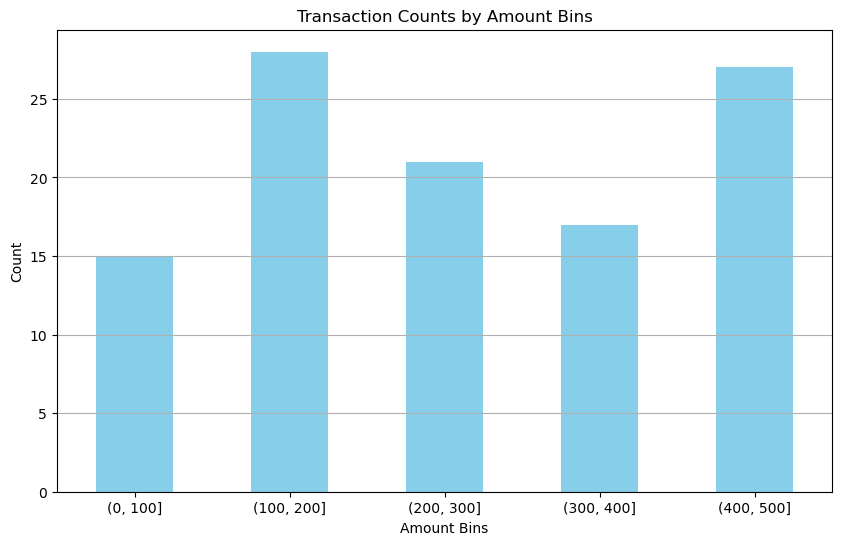

In [21]:
# Define the bin edges
bin_edges = [0, 100, 200, 300, 400, 500]  # Customize these bins as needed

# Create bins for transaction amounts
df['amount_bins'] = pd.cut(df['amount'], bin_edges)

# Count the transactions in each amount bin
transaction_counts_by_bin = df['amount_bins'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
transaction_counts_by_bin.plot(kind='bar', color='skyblue')
plt.title('Transaction Counts by Amount Bins')
plt.xlabel('Amount Bins')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y')
plt.show()


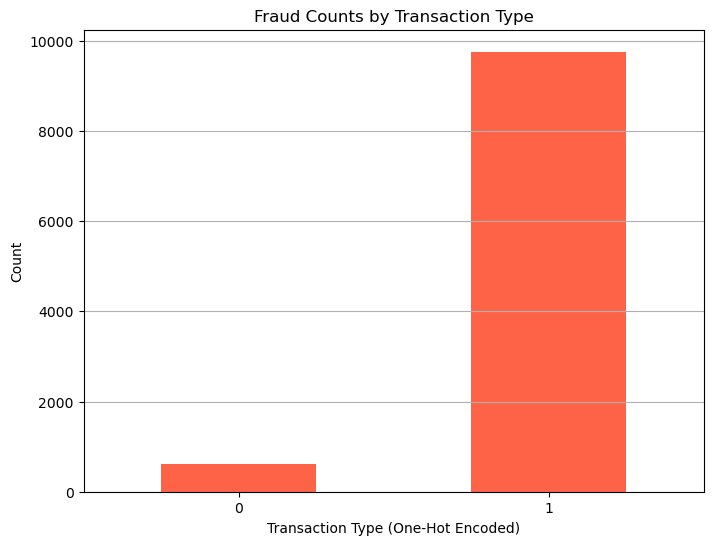

In [22]:
# Create a new column 'fraud_count' that sums the one-hot-encoded columns for each row
df['fraud_count'] = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum(axis=1)

# Group the data by 'fraud_count' and calculate the count of transactions for each 'fraud_count'
fraud_counts_by_type = df.groupby('fraud_count').size()

# Create the bar chart
plt.figure(figsize=(8, 6))
fraud_counts_by_type.plot(kind='bar', color='tomato')
plt.title('Fraud Counts by Transaction Type')
plt.xlabel('Transaction Type (One-Hot Encoded)')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.grid(axis='y')
plt.show()

type_CASH_OUT    2545
type_DEBIT          0
type_PAYMENT        0
type_TRANSFER    2641
isFraud          5186
dtype: int64


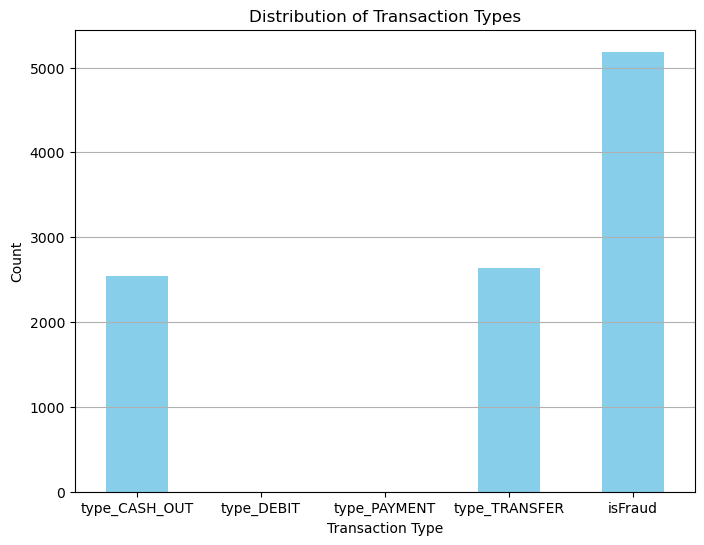

In [23]:
# Count the occurrences of each transaction type
# Select the transaction type columns and 'isFraud' column
transaction_type_columns = ['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']
transaction_type_columns.append('isFraud')

# Filter the DataFrame to include rows where 'isFraud' is true
fraudulent_transactions = df[df['isFraud'] == 1]

# Get the count of true 'isFraud' for each transaction type
transaction_type_counts = fraudulent_transactions[transaction_type_columns].sum()

print(transaction_type_counts)

# Create the bar chart
plt.figure(figsize=(8, 6))
transaction_type_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Transaction Types')
plt.xlabel('Transaction Type')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y')
plt.show()

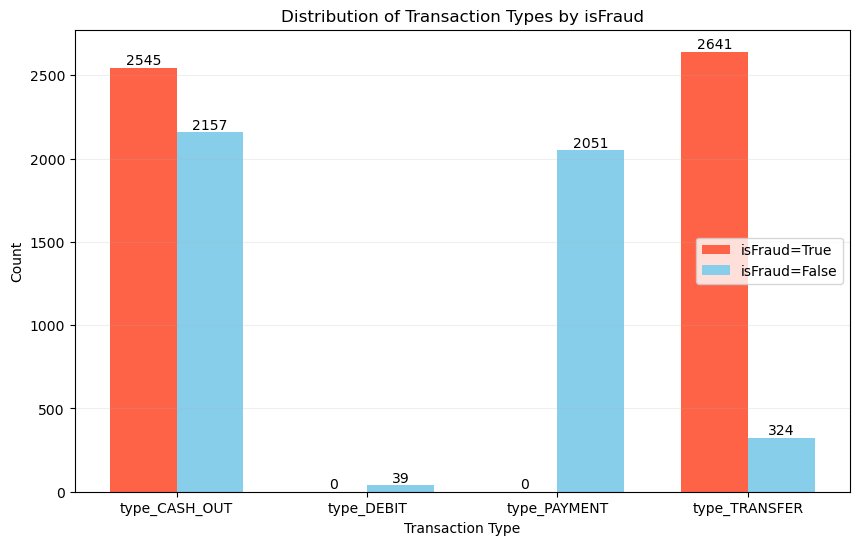

In [24]:
# Define the transaction types
transaction_types = ['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']

# Initialize lists to store counts for 'isFraud' true and false
fraud_counts_true = []
fraud_counts_false = []

# Calculate counts for each transaction type
for transaction_type in transaction_types:
    # 'isFraud' true count
    count_true = len(df[(df[transaction_type] == 1) & (df['isFraud'] == 1)])
    fraud_counts_true.append(count_true)

    # 'isFraud' false count
    count_false = len(df[(df[transaction_type] == 1) & (df['isFraud'] == 0)])
    fraud_counts_false.append(count_false)

# Create the bar chart
plt.figure(figsize=(10, 6))
width = 0.35
x = range(len(transaction_types))

bars1 = plt.bar(x, fraud_counts_true, width, label='isFraud=True', color='tomato')
bars2 = plt.bar([i + width for i in x], fraud_counts_false, width, label='isFraud=False', color='skyblue')

# Add count labels on top of the bars
for bar1, bar2 in zip(bars1, bars2):
    plt.text(bar1.get_x() + bar1.get_width() / 2, bar1.get_height(), str(int(bar1.get_height())),
             ha='center', va='bottom', color='black')
    plt.text(bar2.get_x() + bar2.get_width() / 2, bar2.get_height(), str(int(bar2.get_height())),
             ha='center', va='bottom', color='black')

plt.title('Distribution of Transaction Types by isFraud')
plt.xlabel('Transaction Type')
plt.ylabel('Count')
plt.xticks([i + width/2 for i in x], transaction_types)

# Move the legend to the right side in the middle
plt.legend(loc='center right')

plt.grid(axis='y', alpha=0.2)
plt.show()


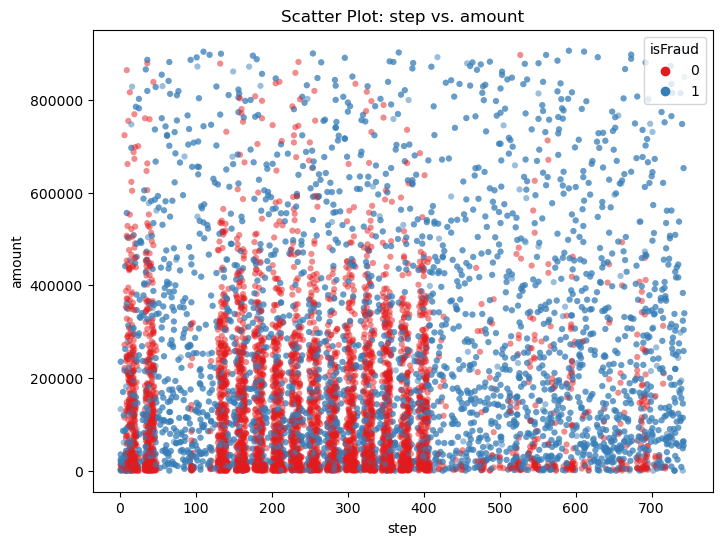

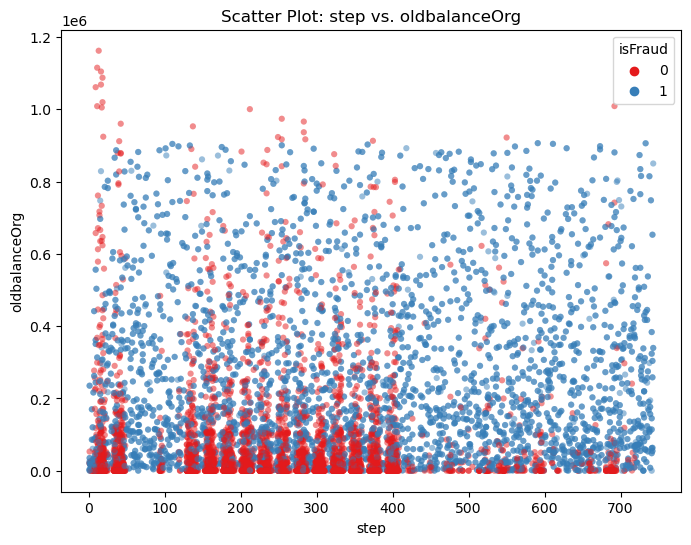

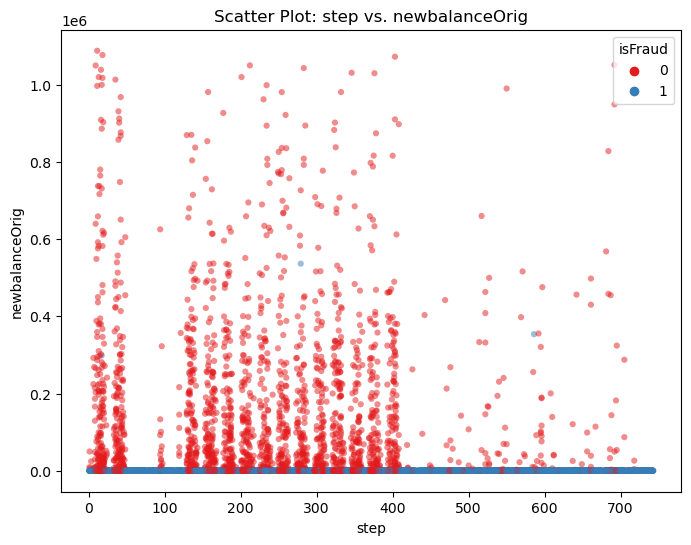

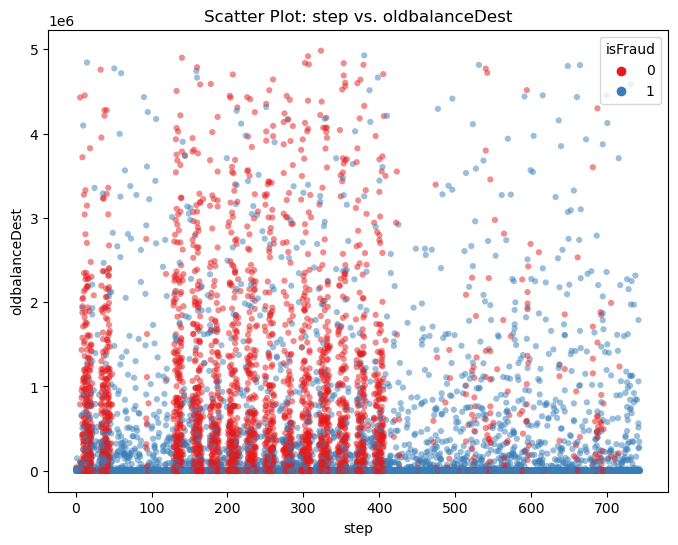

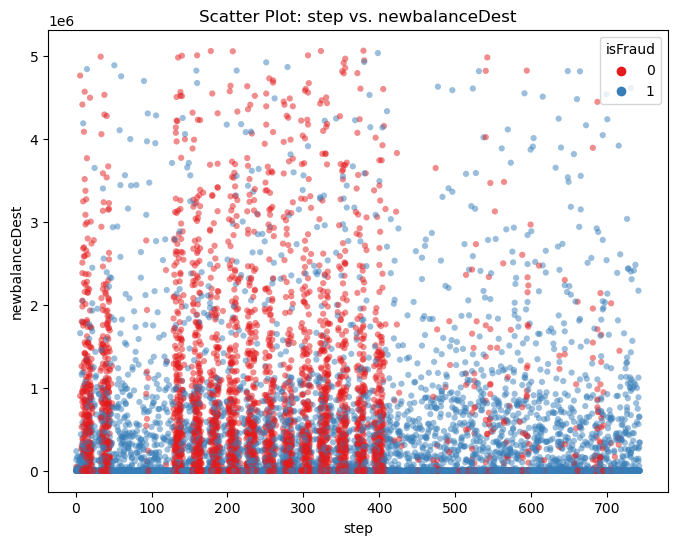

...

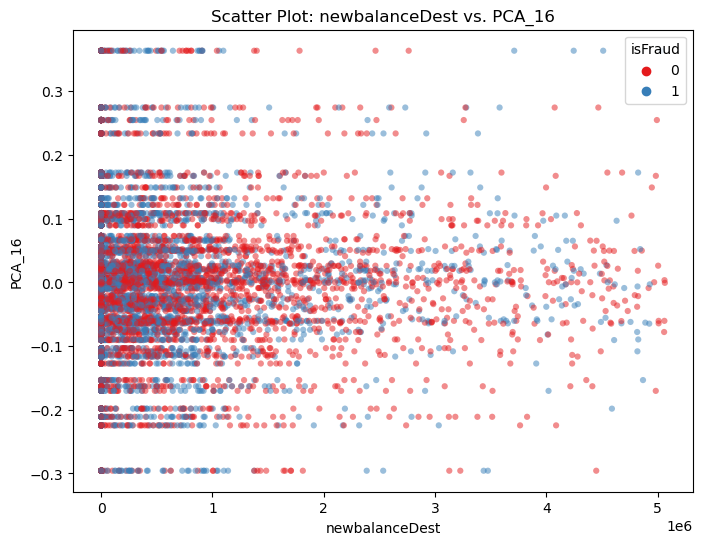

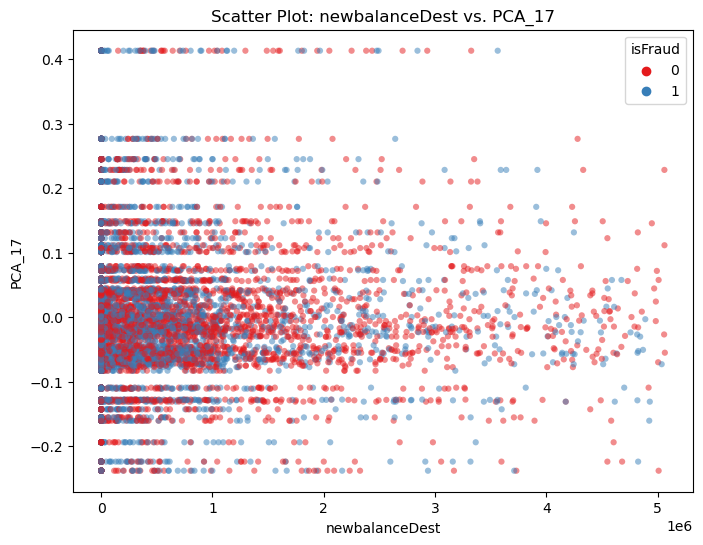

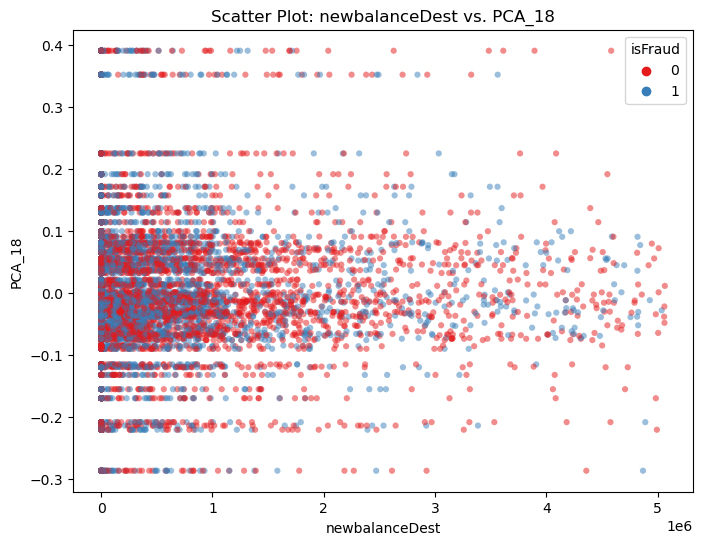

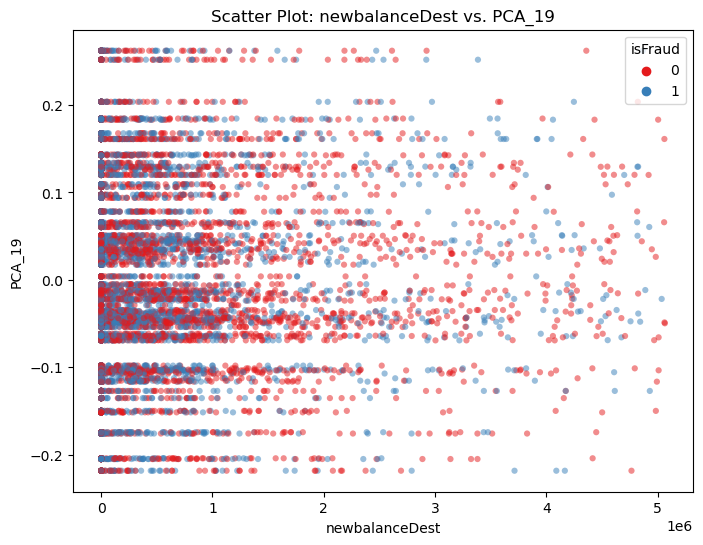

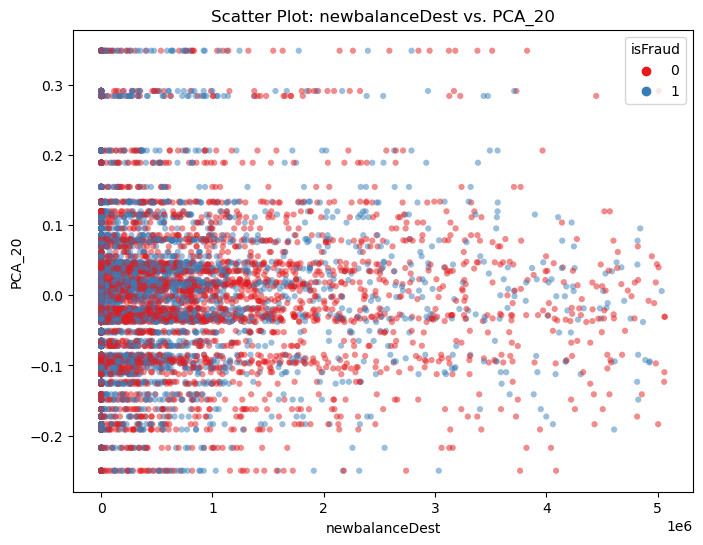

TypeError: boxplot() got an unexpected keyword argument 'alpha'

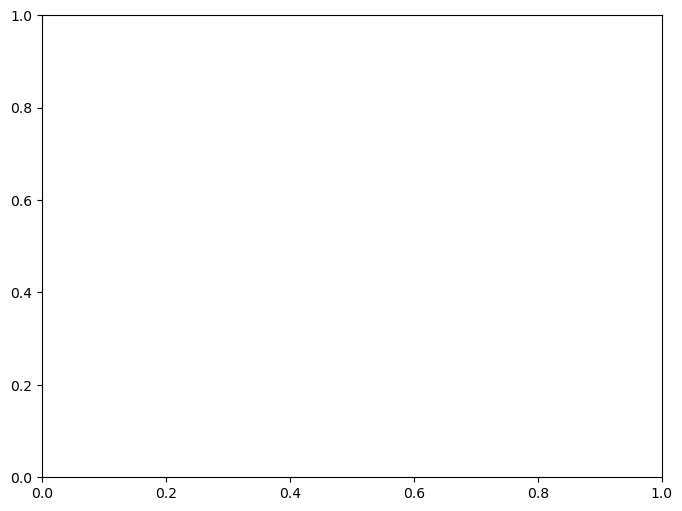

In [25]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Select the attributes for bivariate analysis
attributes = ['step', 'amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest',
              'isFraud', 'isFlaggedFraud', 'type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER',
              'PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
              'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17', 'PCA_18', 'PCA_19', 'PCA_20']

# Generate all possible pairs of attributes for bivariate analysis
bivariate_pairs = [(x, y) for i, x in enumerate(attributes) for j, y in enumerate(attributes) if i < j]

# Plot various types of bivariate data visualizations
for pair in bivariate_pairs:
    x, y = pair

    if x == 'isFraud':
        continue  # Skip 'isFraud' vs. 'isFraud' comparisons

    if x in ['isFraud', 'isFlaggedFraud', 'type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']:
        # For categorical vs. numerical attributes
        plt.figure(figsize=(8, 6))
        sns.boxplot(x=x, y=y, data=df, palette='Set1', alpha=0.5)
        plt.title(f'Box Plot: {x} vs. {y}')
    else:
        # For numerical vs. numerical attributes
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=x, y=y, data=df, hue='isFraud', palette='Set1', edgecolor='none', alpha=0.5, s=20)  # Remove marker outlines
        plt.title(f'Scatter Plot: {x} vs. {y}')

    plt.xlabel(x)
    plt.ylabel(y)
    plt.legend(title='isFraud', loc='upper right')

    plt.show()


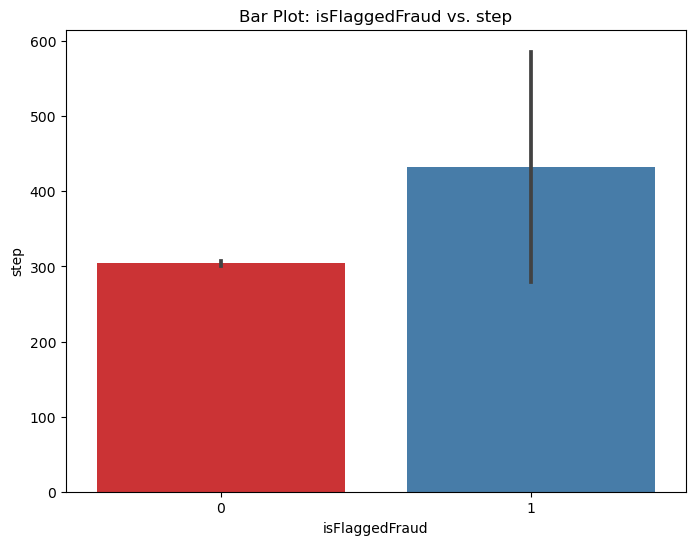

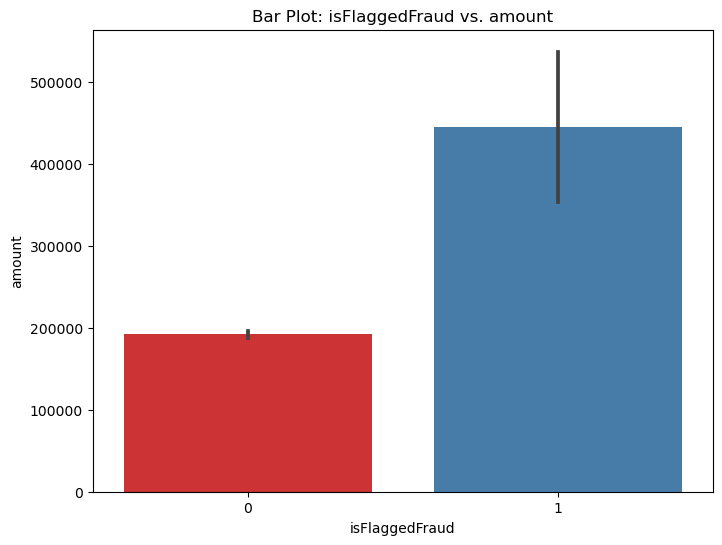

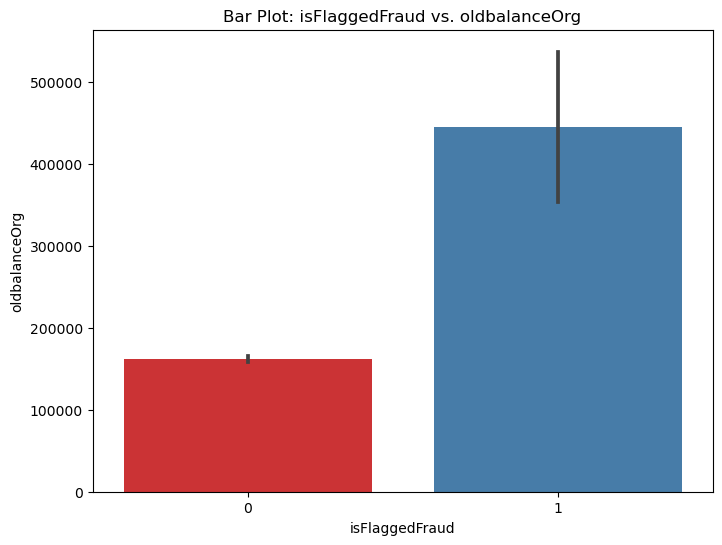

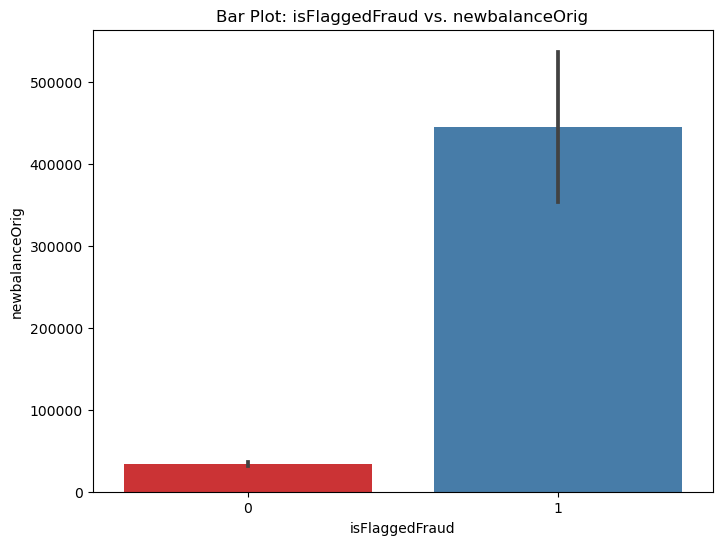

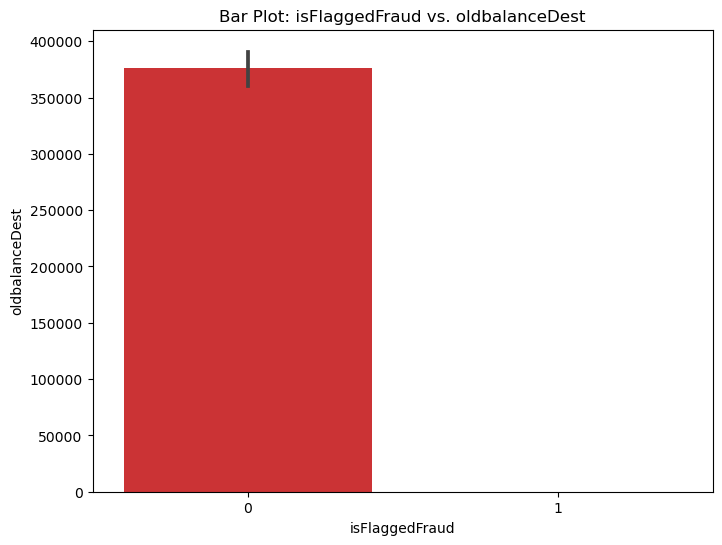

...

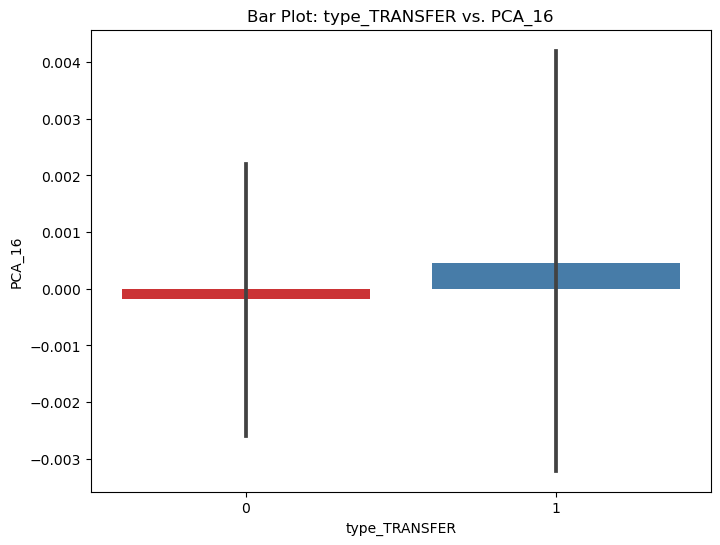

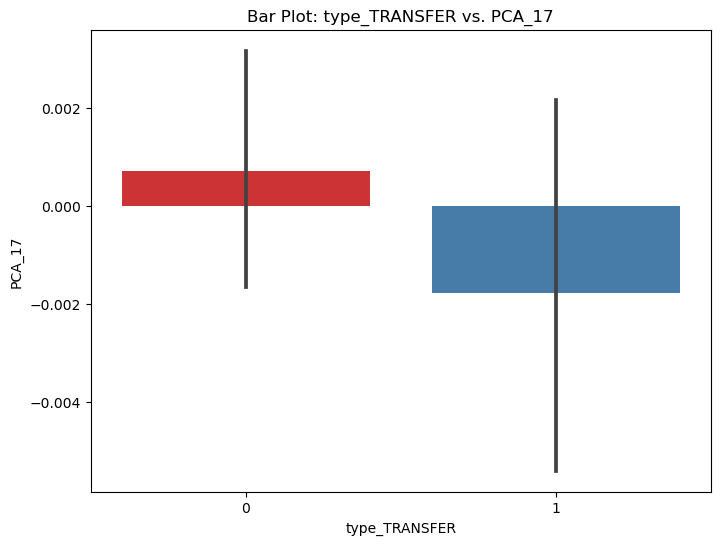

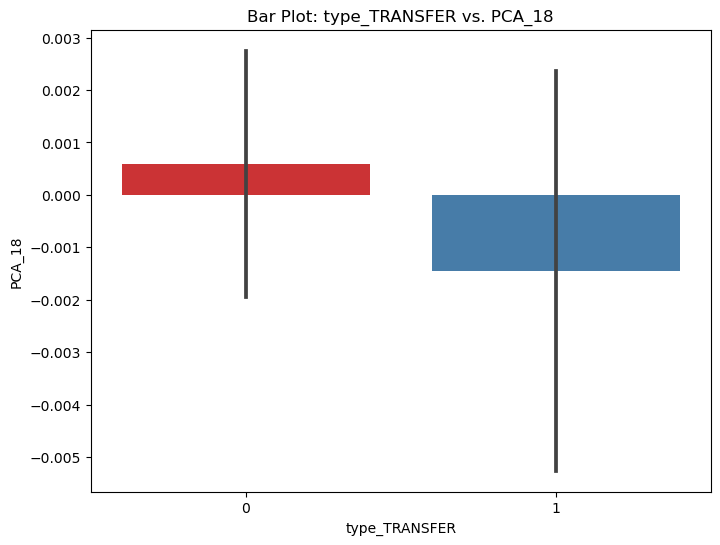

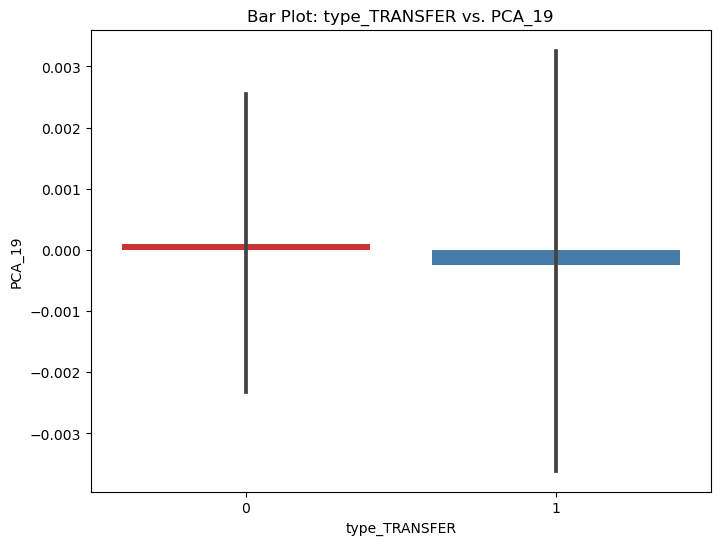

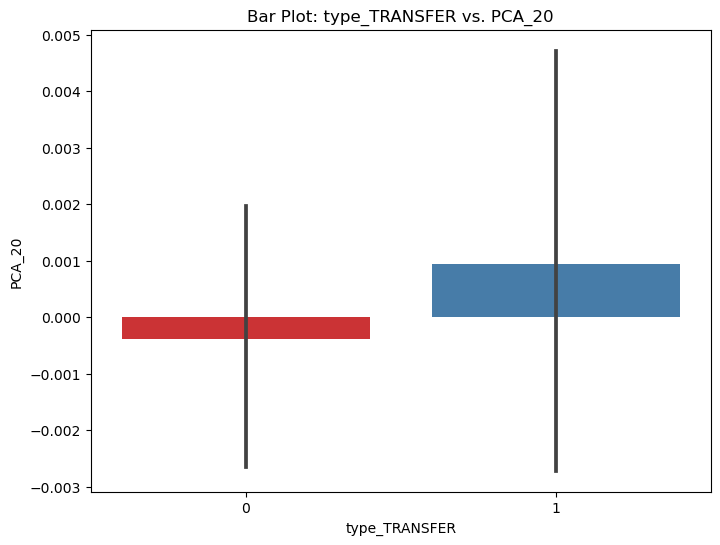

In [26]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Select the attributes for bar plot analysis
categorical_attributes = ['isFraud', 'isFlaggedFraud', 'type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']

# Generate all possible combinations of categorical attributes
categorical_combinations = [(x, y) for x in categorical_attributes for y in categorical_attributes if x != y]

# Generate bar plots for numeric attributes grouped by categorical attributes
for x in categorical_attributes:
    for y in [attr for attr in attributes if attr not in categorical_attributes]:
        if x == 'isFraud':
            continue  # Skip 'isFraud' vs. numerical attributes
        plt.figure(figsize=(8, 6))
        sns.barplot(x=x, y=y, data=df, palette='Set1')
        plt.title(f'Bar Plot: {x} vs. {y}')
        plt.xlabel(x)
        plt.ylabel(y)
        plt.show()


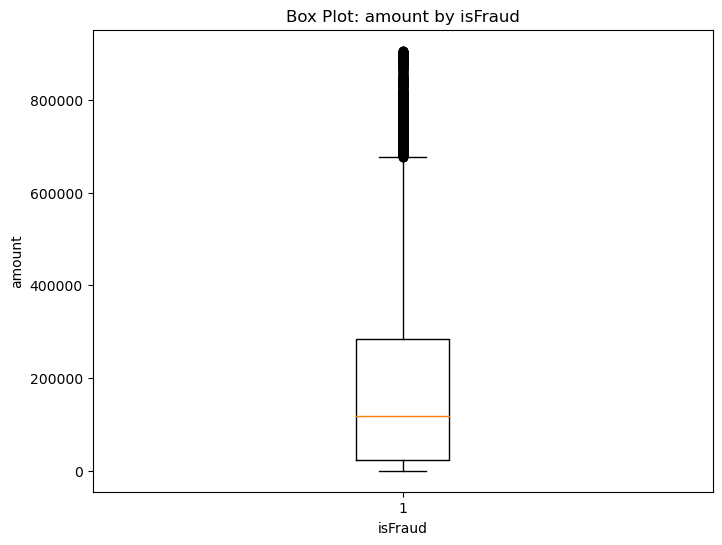

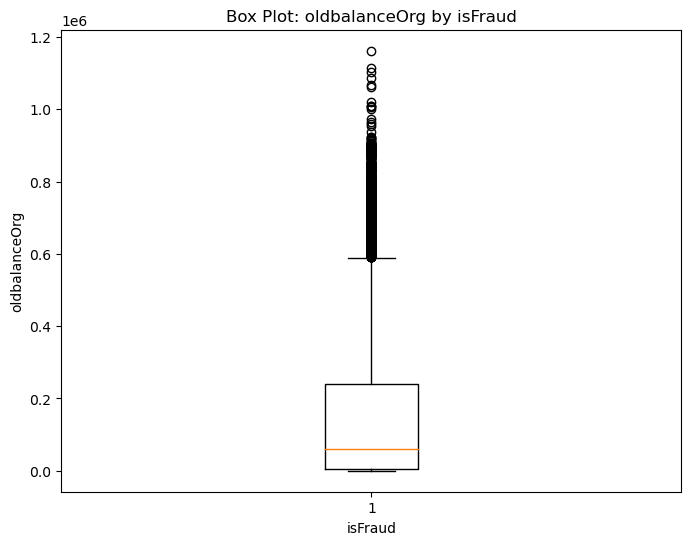

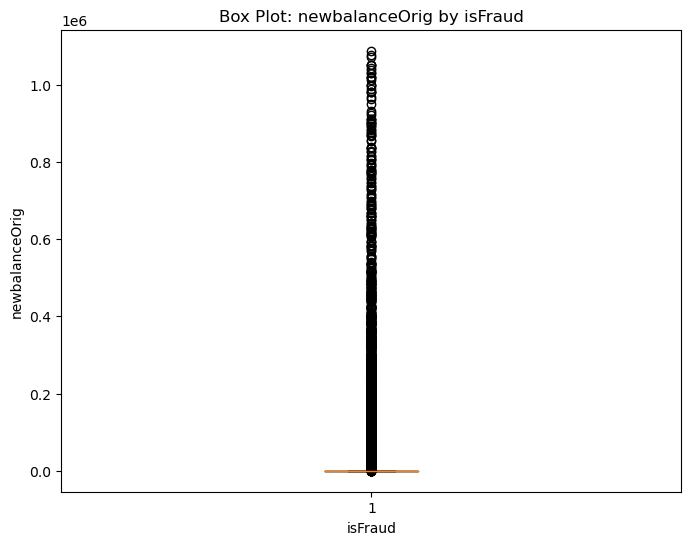

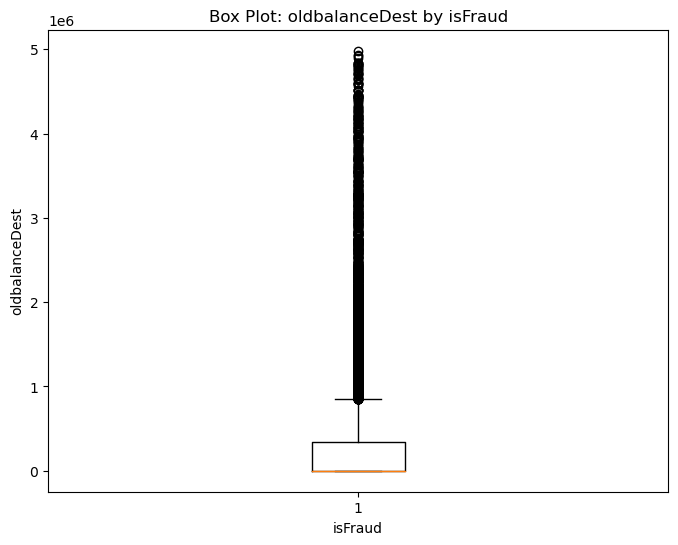

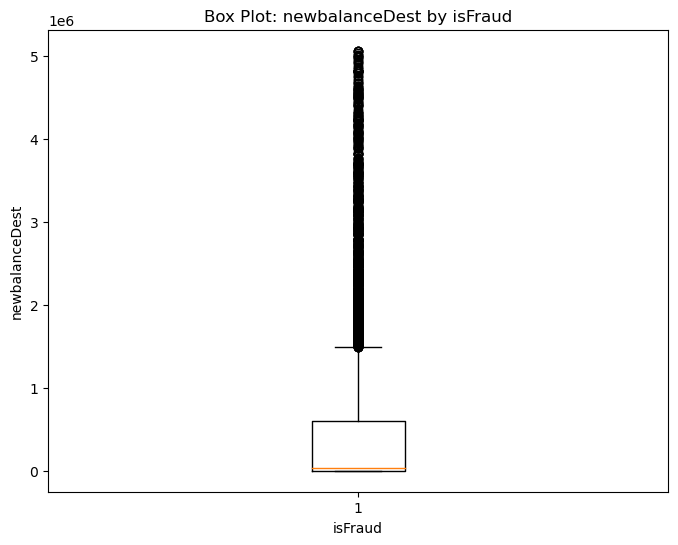

In [27]:
# Select the attributes for box plot analysis
attributes = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Generate box plots for each selected attribute
for attribute in attributes:
    plt.figure(figsize=(8, 6))
    plt.boxplot(df[attribute])
    plt.title(f'Box Plot: {attribute} by isFraud')
    plt.xlabel('isFraud')
    plt.ylabel(attribute)
    plt.show()

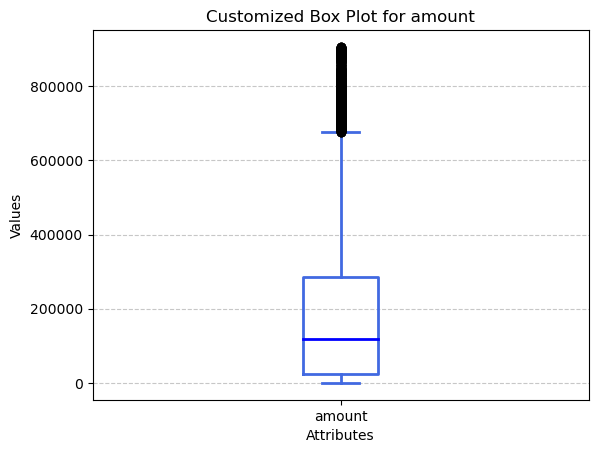

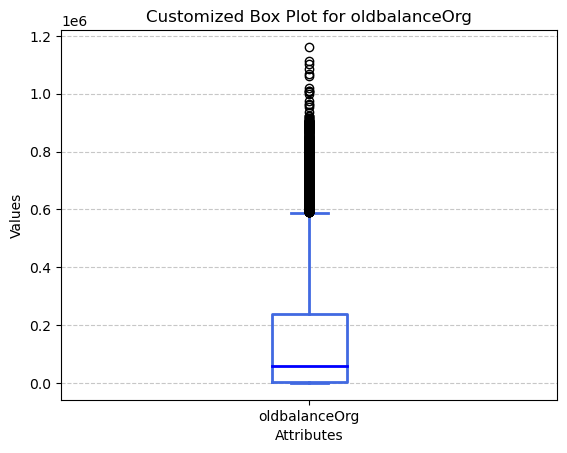

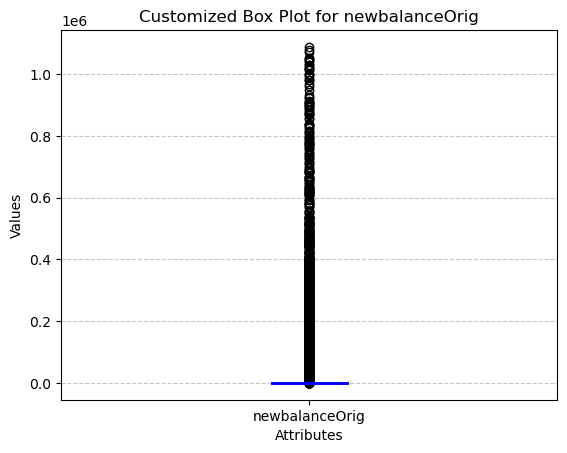

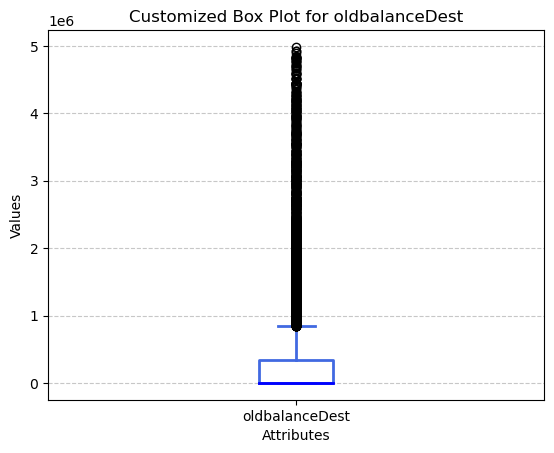

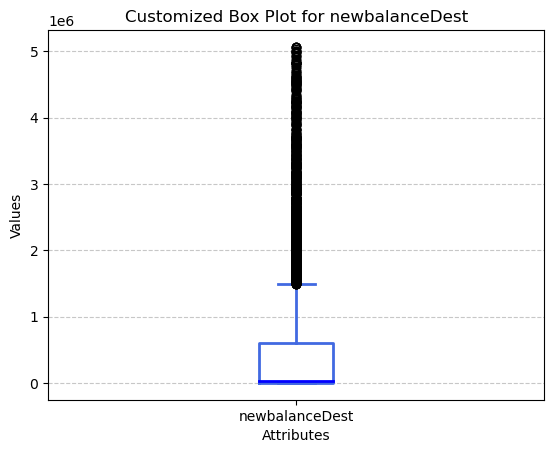

In [28]:
import pandas as pd
import matplotlib.pyplot as plt

# Select the attributes for box plot analysis
attributes = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Customize the appearance of the box plots
customizations = {
    'boxes': dict(color='royalblue', linewidth=2),
    'whiskers': dict(color='royalblue', linewidth=2),
    'caps': dict(color='royalblue', linewidth=2),
    'medians': dict(color='blue', linewidth=2),
}

# Create box plots for each selected attribute
for attribute in attributes:
    # Create the box plot and store the box plot properties
    box = plt.boxplot(df[attribute], labels=[attribute])

    # Apply customizations to the box plot elements
    for element, customization in customizations.items():
        plt.setp(box[element], **customization)

    # Add horizontal grid lines
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Set axis labels and title
    plt.xlabel('Attributes')
    plt.ylabel('Values')
    plt.title(f'Customized Box Plot for {attribute}')

    plt.show()


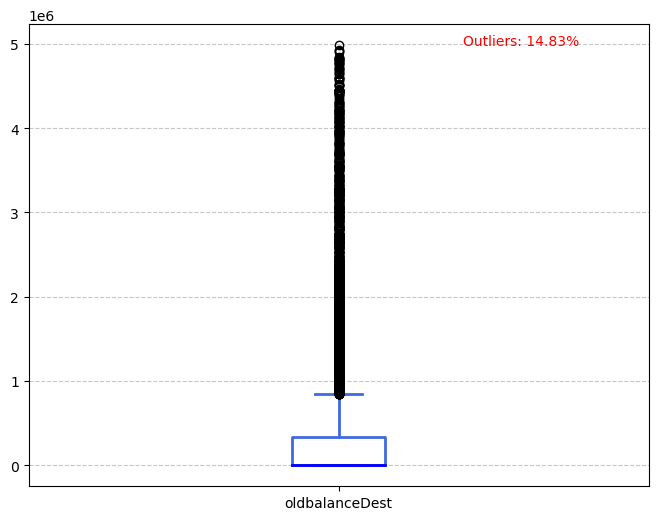

In [47]:
import pandas as pd
import matplotlib.pyplot as plt

# Select the attribute for the box plot analysis
attribute = 'oldbalanceDest'

# Create the box plot
plt.figure(figsize=(8, 6))
box = plt.boxplot(df[attribute], labels=[attribute])

# Customize the appearance of the box plot elements
customizations = {
    'boxes': dict(color='royalblue', linewidth=2),
    'whiskers': dict(color='royalblue', linewidth=2),
    'caps': dict(color='royalblue', linewidth=2),
    'medians': dict(color='blue', linewidth=2),
}

# Apply customizations to the box plot elements
for element, customization in customizations.items():
    plt.setp(box[element], **customization)

# Calculate the percentage of outliers
q1 = df[attribute].quantile(0.25)
q3 = df[attribute].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df[attribute] < lower_bound) | (df[attribute] > upper_bound)]
outlier_percentage = len(outliers) / len(df) * 100

# Add a text annotation for the outlier percentage
plt.annotate(f'Outliers: {outlier_percentage:.2f}%', xy=(1.2, df[attribute].max() + 5), color='red')

# Add horizontal grid lines
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


Text(0.5, 1.0, 'Box Plot: type_TRANSFER vs. PCA_20')

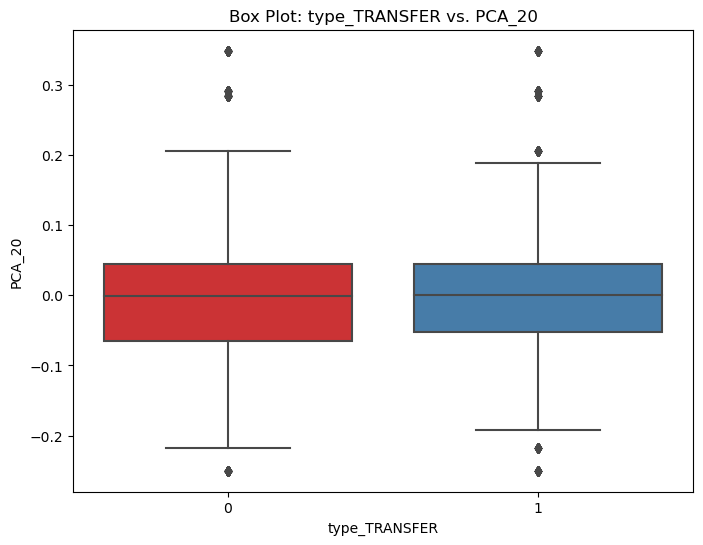

In [30]:
# For categorical vs. numerical attributes
plt.figure(figsize=(8, 6))
sns.boxplot(x=x, y=y, data=df, palette='Set1')
plt.title(f'Box Plot: {x} vs. {y}')

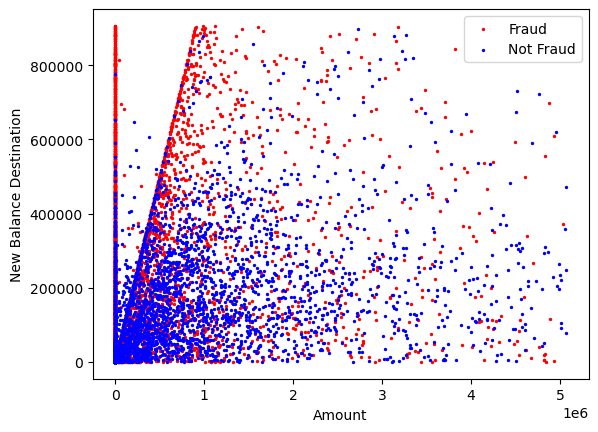

In [31]:
# Create a scatter plot
plt.scatter( df[df['isFraud'] == 1]['newbalanceDest'], df[df['isFraud'] == 1]['amount'],s=2, c='red', label='Fraud')
plt.scatter(df[df['isFraud'] == 0]['newbalanceDest'],df[df['isFraud'] == 0]['amount'], s=2, c='blue', label='Not Fraud')

# Set labels and legend
plt.xlabel('Amount')
plt.ylabel('New Balance Destination')
plt.legend()

plt.show()

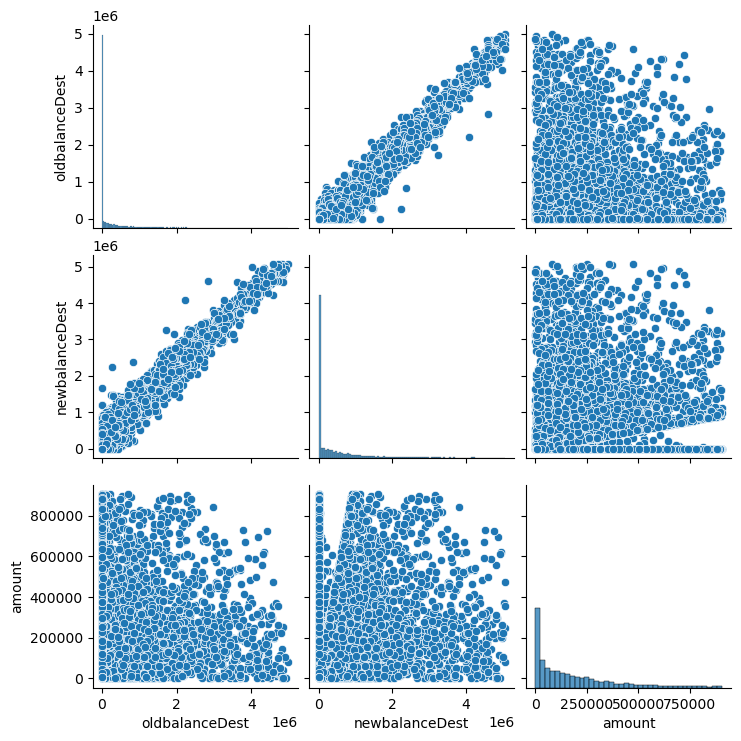

In [32]:
# Example data (replace with your actual data)
data = df[['oldbalanceDest', 'newbalanceDest', 'amount']]

# Create a scatter plot matrix
sns.pairplot(data)
plt.show()

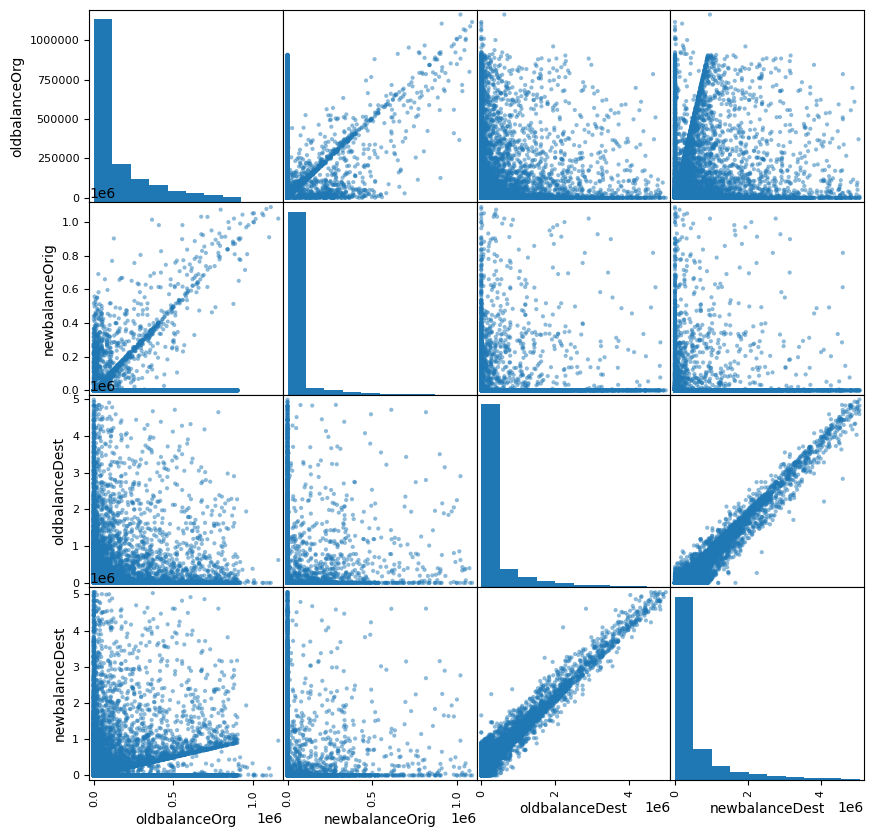

In [33]:
pd.plotting.scatter_matrix(df[['oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest',
       'newbalanceDest']],figsize=(10, 10))
plt.show()

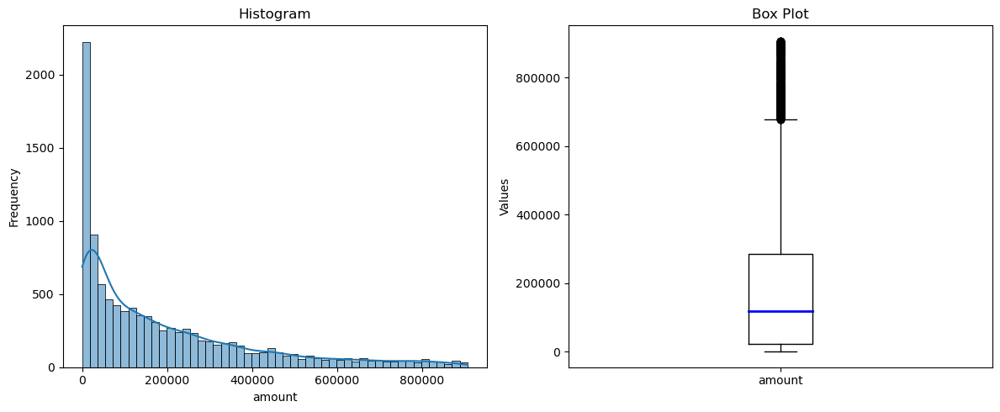

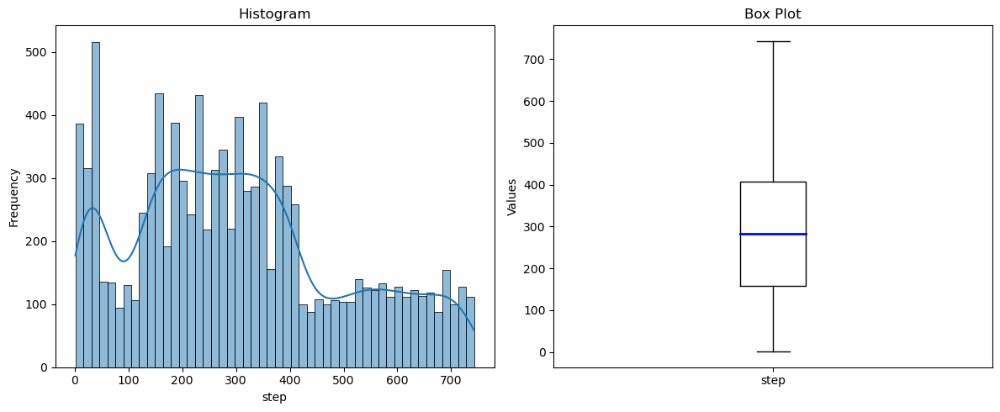

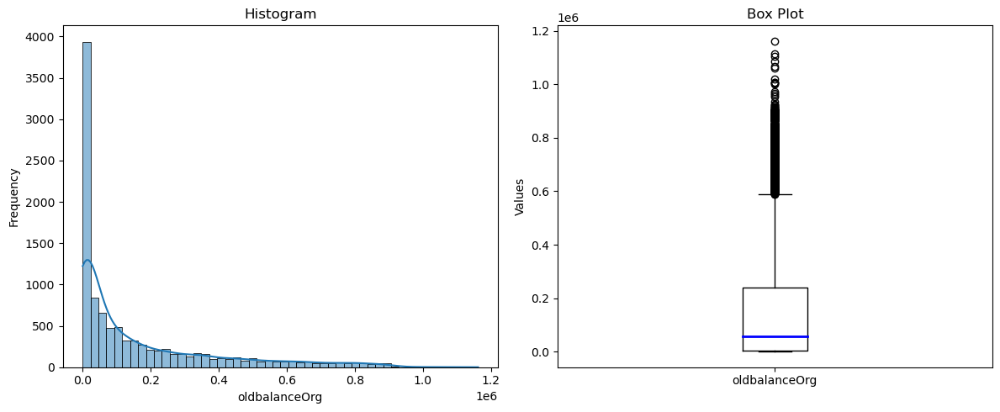

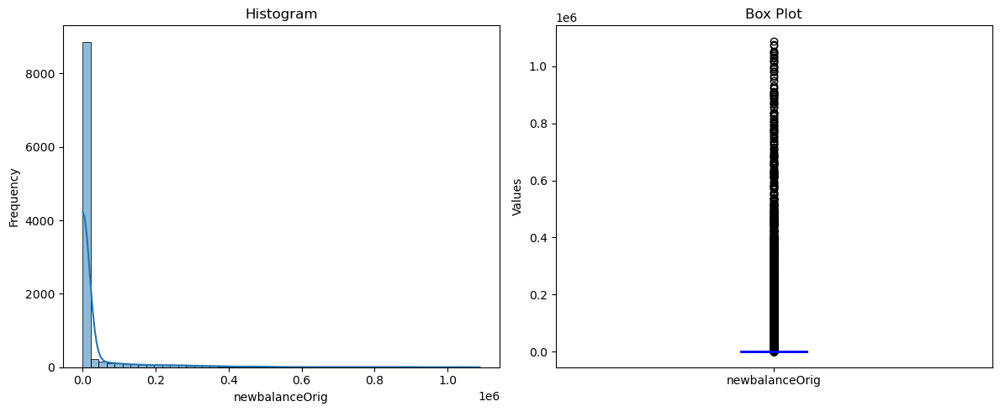

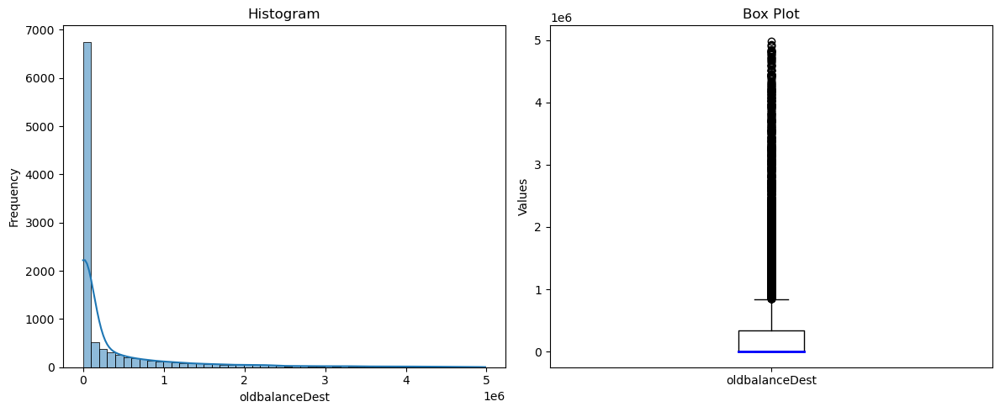

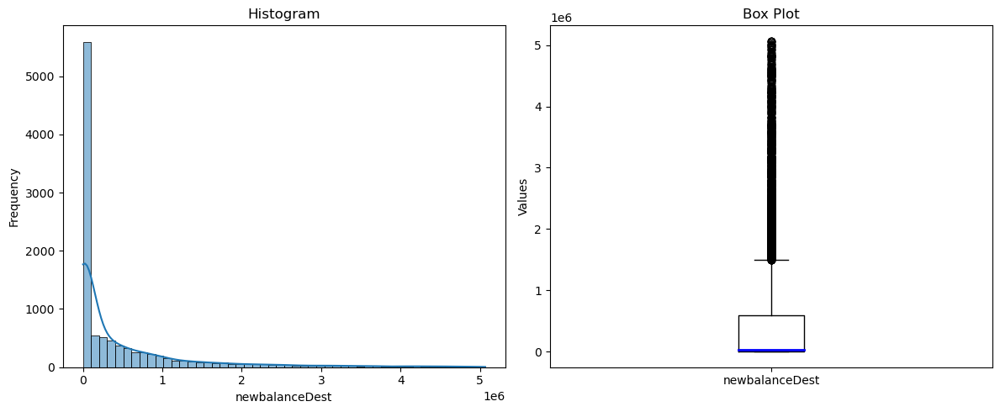

In [34]:
atts = ['amount', 'step' ,'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest',
       'newbalanceDest']
for attribute in atts:
  # Create a figure with two subplots
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

  # Create a histogram in the first subplot
  sns.histplot(data=df[attribute], bins=50,kde=True, fill=True, alpha=0.5, ax=ax1)
  ax1.set_xlabel(attribute)
  ax1.set_ylabel('Frequency')
  ax1.set_title('Histogram')

  # Create a box plot in the second subplot
  ax2.boxplot(df[attribute])['medians'][0].set(color='blue', linewidth=2)
  ax2.set_ylabel('Values')
  ax2.set_xticklabels([attribute])
  ax2.set_title('Box Plot')

  # Adjust the layout to prevent overlap
  plt.tight_layout()

  # Show the subplots
  plt.show()

<AxesSubplot:xlabel='amount', ylabel='Count'>

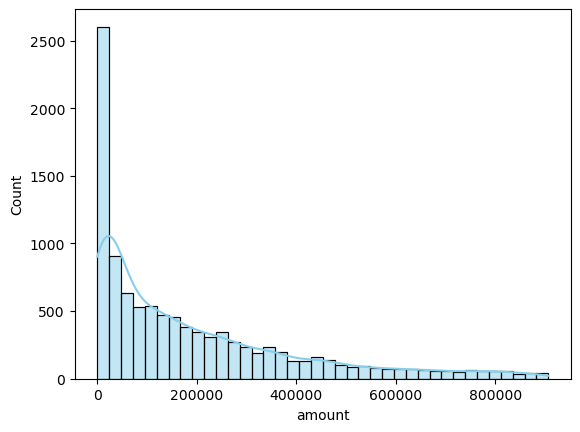

In [35]:
sns.histplot(df['amount'], kde=True, color='skyblue', line_kws={'color': 'green'})

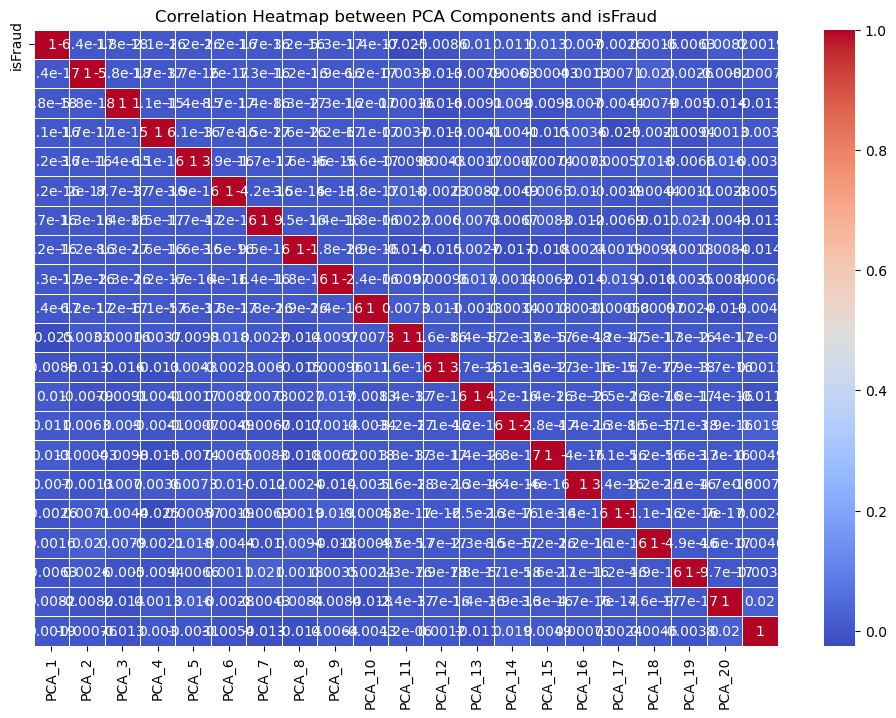

In [36]:
# Select the PCA components and 'isFraud' column
pca_components = df[['PCA_1', 'PCA_2',
       'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
       'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17',
       'PCA_18', 'PCA_19', 'PCA_20']]
is_fraud = df[['isFraud']]

# Create a combined DataFrame for correlation calculation
correlation_df = pd.concat([pca_components, is_fraud], axis=1)

# Calculate the correlation matrix
correlation_matrix = correlation_df.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', xticklabels=pca_components.columns,
            yticklabels=['isFraud'], cbar=True, linewidths=0.5)

plt.title('Correlation Heatmap between PCA Components and isFraud')
plt.show()


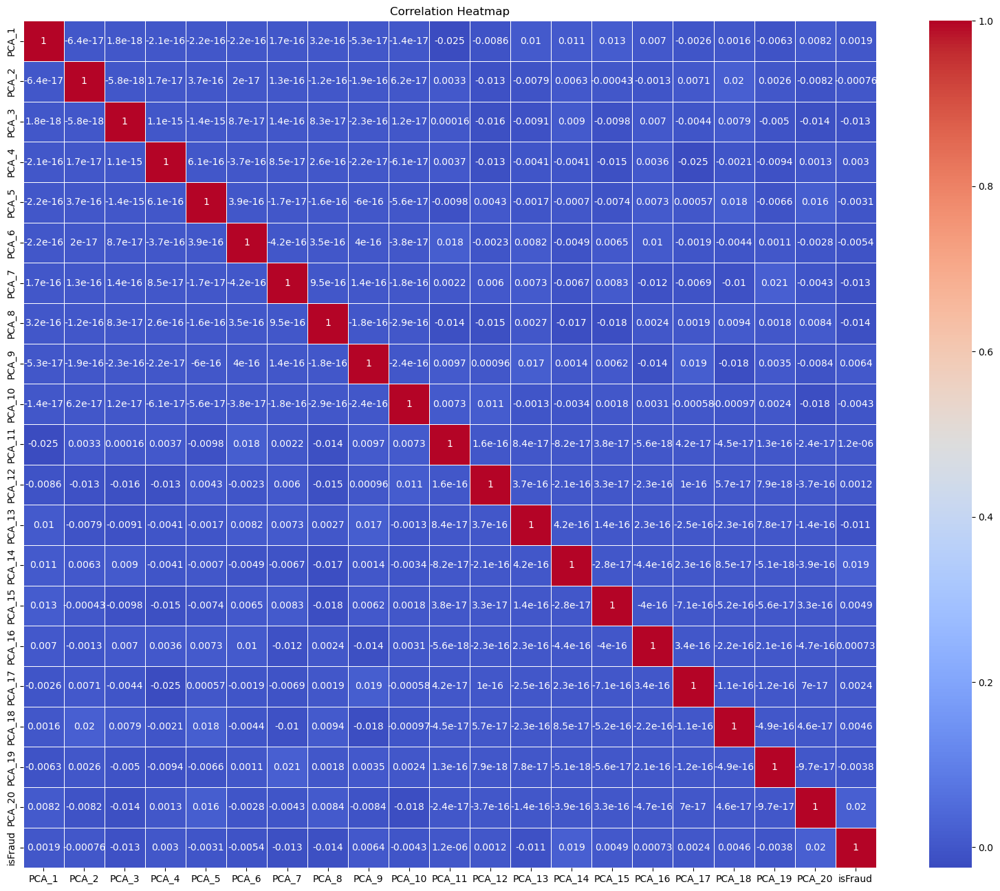

In [37]:
selected_features = df[['PCA_1', 'PCA_2',
       'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
       'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17',
       'PCA_18', 'PCA_19', 'PCA_20', 'isFraud']]

correlation_matrix = selected_features.corr()

plt.figure(figsize=(20, 16))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

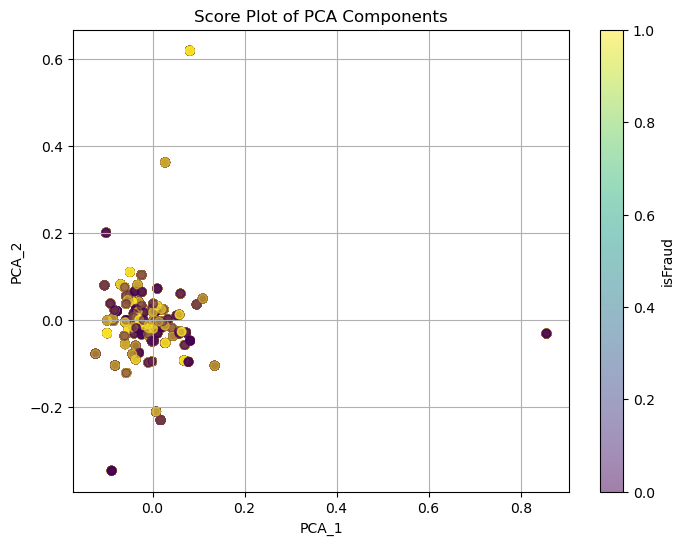

In [38]:
# Select the first and second principal components for the score plot
pca1 = pca_components['PCA_1']
pca2 = pca_components['PCA_2']

# Create a score plot
plt.figure(figsize=(8, 6))
plt.scatter(pca1, pca2, c=df['isFraud'], cmap='viridis', alpha=0.5)
cbar = plt.colorbar()
cbar.set_label('isFraud')

plt.xlabel('PCA_1')
plt.ylabel('PCA_2')
plt.title('Score Plot of PCA Components')
plt.grid()
plt.show()


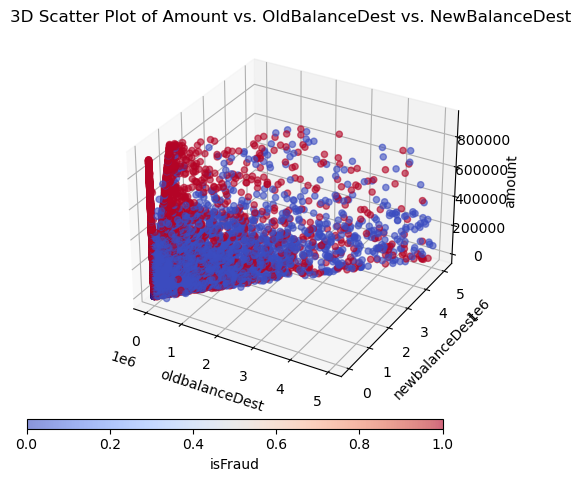

<Figure size 800x600 with 0 Axes>

In [39]:
from mpl_toolkits.mplot3d import Axes3D

# Create a score plot
fig = plt.figure()
plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
a = ax.scatter(df['oldbalanceDest'], df['newbalanceDest'], df['amount'], c=df['isFraud'], cmap='coolwarm', alpha=0.6)

# Set labels for the axes
ax.set_zlabel('amount')
ax.set_xlabel('oldbalanceDest')
ax.set_ylabel('newbalanceDest')

# Add a title
ax.set_title('3D Scatter Plot of Amount vs. OldBalanceDest vs. NewBalanceDest')

cax = fig.add_axes([0.1, 0.05, 0.65, 0.02])  # [left, bottom, width, height]
cbar = fig.colorbar(a, cax=cax, orientation='horizontal')
cbar.set_label('isFraud')

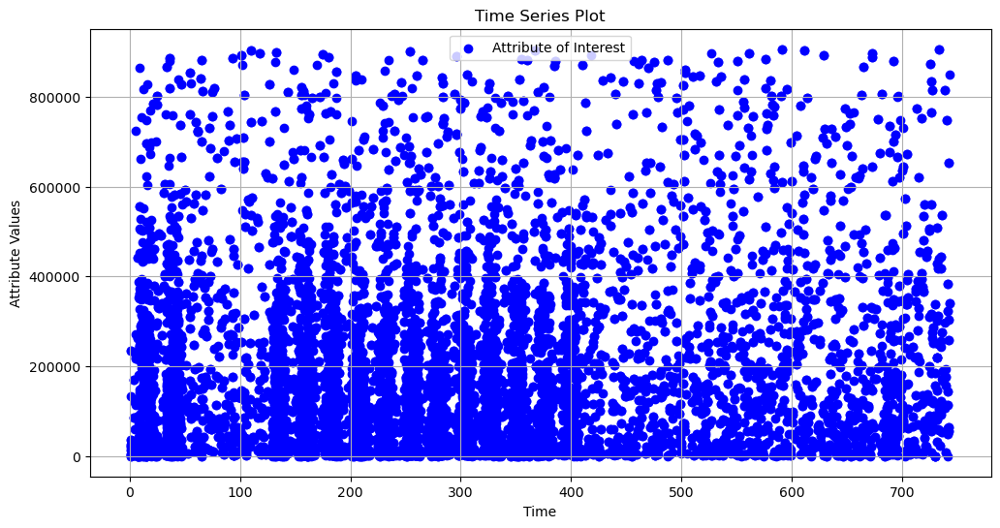

In [40]:
# Create a time series plot
plt.figure(figsize=(12, 6))
plt.scatter(df['step'], df['amount'], color='blue', label='Attribute of Interest')
plt.xlabel('Time')
plt.ylabel('Attribute Values')
plt.title('Time Series Plot')
plt.legend()
plt.grid(True)
plt.show()

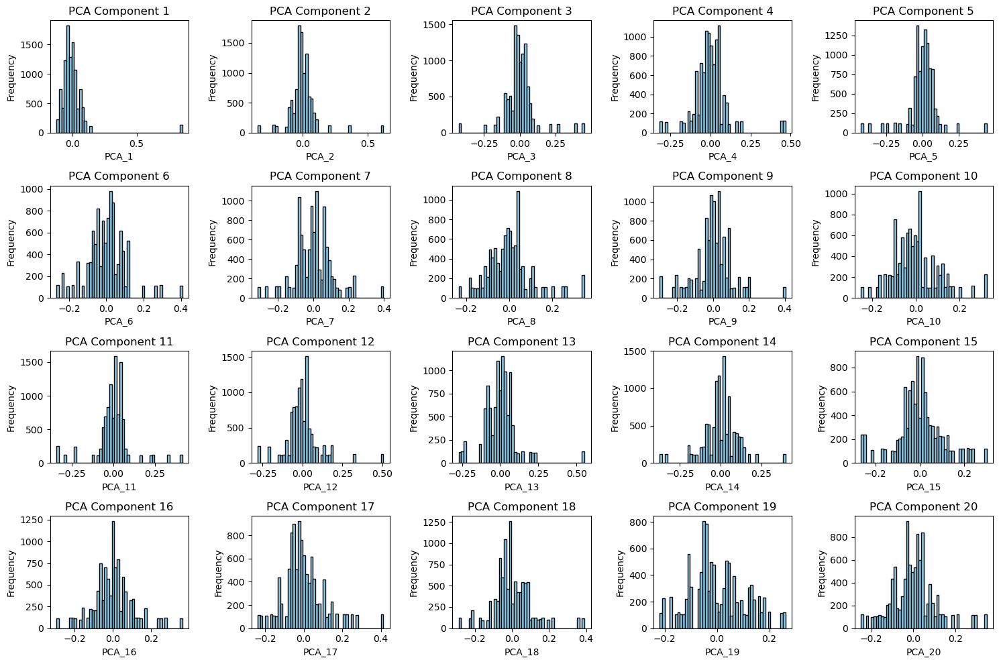

In [41]:
import matplotlib.pyplot as plt

pca_columns = ['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
               'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17', 'PCA_18', 'PCA_19', 'PCA_20']

# Define the number of rows and columns for subplots
n_rows = 4
n_cols = 5

# Create a figure with subplots
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Iterate through PCA columns and create subplots
for i, pca_col in enumerate(pca_columns):
    ax = axs[i]  # Select the current subplot
    ax.hist(df[pca_col], bins=50, color='skyblue', edgecolor='black')
    ax.set_title(f'PCA Component {i + 1}')
    ax.set_xlabel(pca_col)
    ax.set_ylabel('Frequency')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()

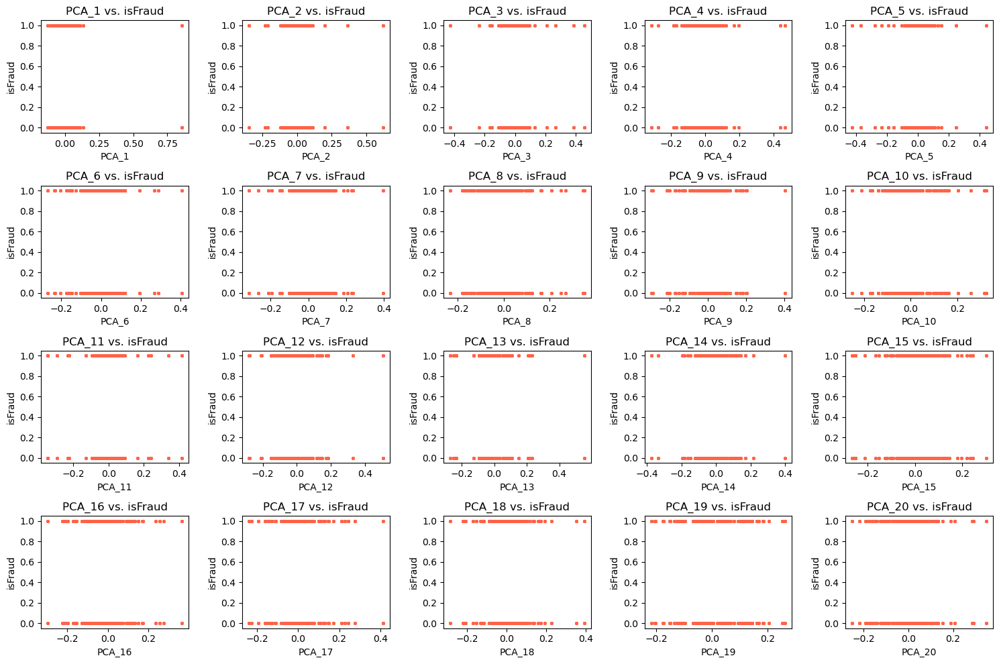

In [42]:
import matplotlib.pyplot as plt

pca_columns = ['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
               'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17', 'PCA_18', 'PCA_19', 'PCA_20']

# Create a figure with subplots
fig, axs = plt.subplots(nrows=4, ncols=5, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Iterate through PCA columns and create scatter plots
for i, pca_col in enumerate(pca_columns):
    ax = axs[i]  # Select the current subplot
    ax.scatter(df[pca_col], df['isFraud'], s=5, color='tomato', alpha=0.5)
    ax.set_title(f'PCA_{i + 1} vs. isFraud')
    ax.set_xlabel(pca_col)
    ax.set_ylabel('isFraud')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


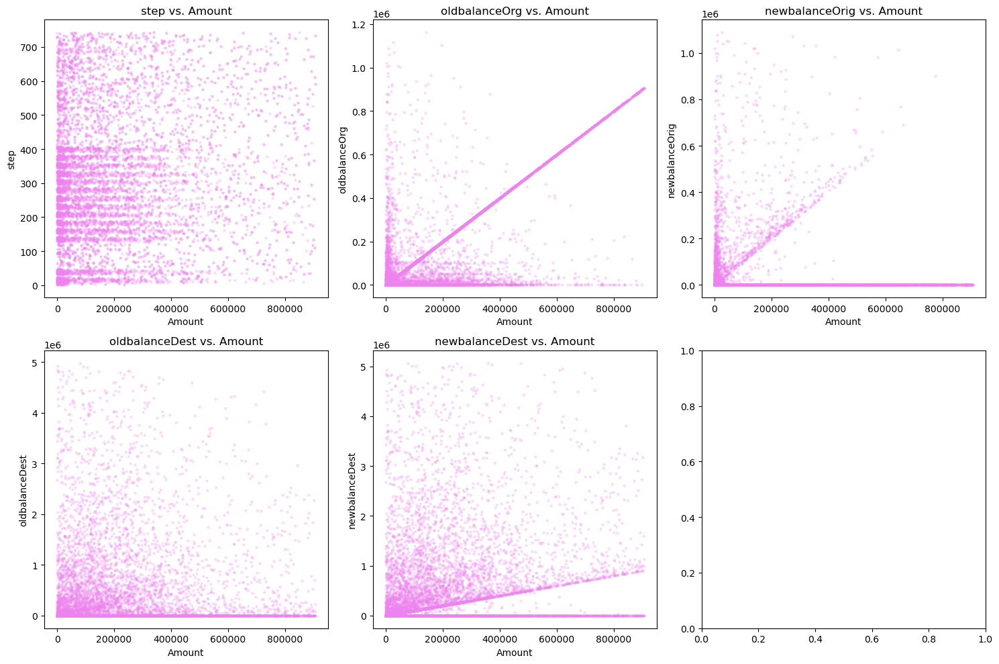

In [43]:
import matplotlib.pyplot as plt

# List of attributes to plot
attributes = ['step', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Iterate through attributes and create scatter plots
for i, attr in enumerate(attributes):
    ax = axs[i]  # Select the current subplot
    ax.scatter(df['amount'], df[attr], s=5, color='violet', alpha=0.2)
    ax.set_title(f'{attr} vs. Amount')
    ax.set_xlabel('Amount')
    ax.set_ylabel(attr)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


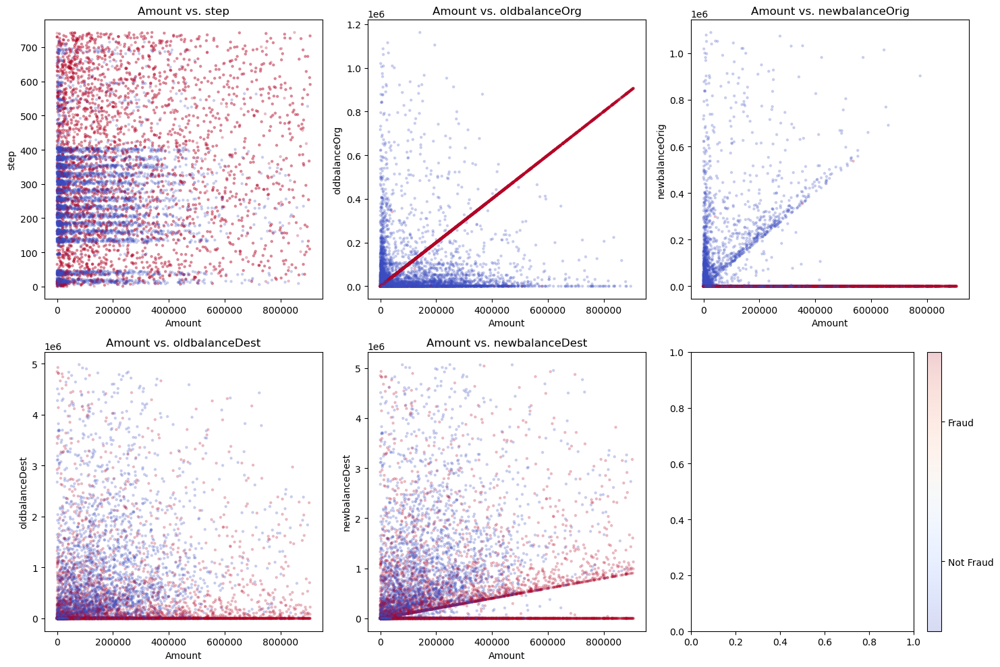

In [44]:
import matplotlib.pyplot as plt
import numpy as np

# List of attributes to plot
attributes = ['step', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Define a colormap for isFraud
cmap = plt.get_cmap('Set1', 2)  # Choose a colormap with 2 colors (for isFraud)

# Map isFraud values to colors
colors = [cmap(i) for i in df['isFraud']]

# Iterate through attributes and create scatter plots with color strip
for i, attr in enumerate(attributes):
    if i < len(axs):
        ax = axs[i]  # Select the current subplot
        scatter = ax.scatter(df['amount'], df[attr], s=5, c=df['isFraud'], cmap='coolwarm', alpha=0.2)
        ax.set_title(f'Amount vs. {attr}')
        ax.set_xlabel('Amount')
        ax.set_ylabel(attr)

# Add a colorbar to the last subplot
cbar = plt.colorbar(scatter, ax=axs[-1])
cbar.set_ticks([0.25, 0.75])
cbar.set_ticklabels(['Not Fraud', 'Fraud'])

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


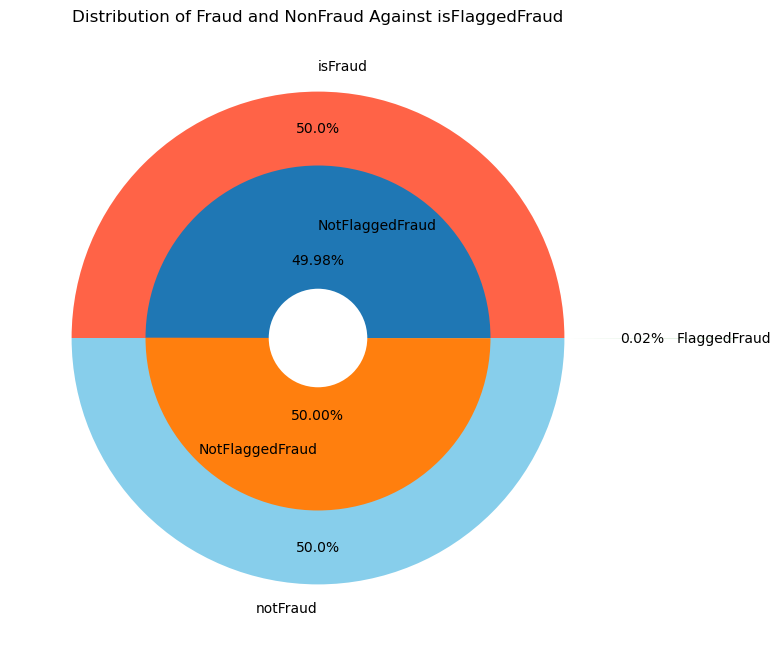

In [45]:
labels = ['NotFlaggedFraud', 'NotFlaggedFraud', 'FlaggedFraud']
plt.figure(figsize=(8,8))
explode = (0, 2)
transaction = 'type_DEBIT'
plt.pie(df['isFraud'].value_counts(), labels=['isFraud', 'notFraud'],autopct='%1.1f%%', startangle=0, pctdistance=0.85, colors=['tomato','skyblue'])
fraud_in_type = len(df[(df['isFlaggedFraud'] == 1) & (df['isFraud'] == 1)])
#not_fraud_in_type = len(df[(df['isFlaggedFraud'] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df['isFlaggedFraud'] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df['isFlaggedFraud'] == 0) & (df['isFraud'] == 0)])

ins=plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type],
            labels=labels,
      autopct="%0.2f%%",radius=0.7,pctdistance=0.45,labeldistance=0.65,startangle=0, explode=(0,0,1))
hole = plt.Circle((0, 0), 0.2, color='white', linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(hole)
plt.title("Distribution of Fraud and NonFraud Against isFlaggedFraud")
plt.show()



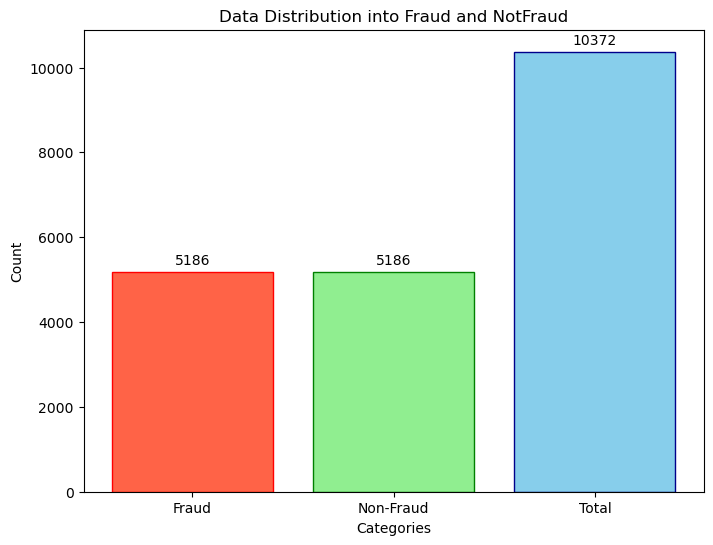

In [46]:
import matplotlib.pyplot as plt

fraud_count = len(df[df['isFraud']==1])
non_fraud_count = len(df[df['isFraud']==0])
total_count = fraud_count + non_fraud_count

# Create a bar plot with three bars
categories = ['Fraud', 'Non-Fraud', 'Total']
counts = [fraud_count, non_fraud_count, total_count]
colors = ['tomato', 'lightgreen', 'skyblue']
outline_colors = ['red', 'green', 'darkblue']

plt.figure(figsize=(8, 6))
bars = plt.bar(categories, counts, color=colors, edgecolor=outline_colors)

# Add values on top of the bars
for bar in bars:
    height = bar.get_height()
    plt.annotate(f'{int(height)}', xy=(bar.get_x() + bar.get_width() / 2, height),
                 xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

# Set axis labels and title
plt.xlabel('Categories')
plt.ylabel('Count')
plt.title('Data Distribution into Fraud and NotFraud')

# Show the plot
plt.show()


# PHASE 3: MODEL TRAINING AND EVALUATION

## Training with PCA

Metrics for Random Forest:
Accuracy: 0.9725301204819277
Confusion Matrix:
[[ 994   42]
 [  15 1024]]
Precision: 0.9606003752345216
Recall: 0.9855630413859481
F1 Score: 0.9729216152019003
ROC AUC Score: 0.9725112504227037


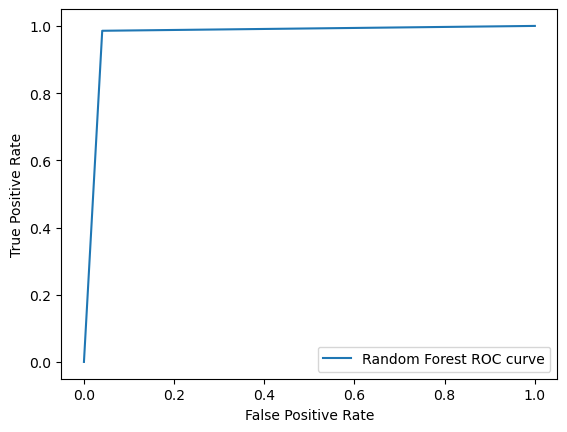

Metrics for Logistic Regression:
Accuracy: 0.9686746987951808
Confusion Matrix:
[[ 980   56]
 [   9 1030]]
Precision: 0.9484346224677717
Recall: 0.9913378248315688
F1 Score: 0.9694117647058824
ROC AUC Score: 0.9686418853887575


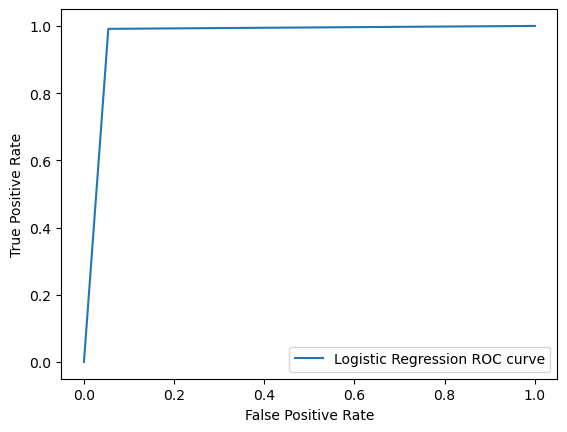

Metrics for Support Vector Classifier:
Accuracy: 0.9426506024096386
Confusion Matrix:
[[968  68]
 [ 51 988]]
Precision: 0.9356060606060606
Recall: 0.9509143407122232
F1 Score: 0.943198090692124
ROC AUC Score: 0.9426386375375789


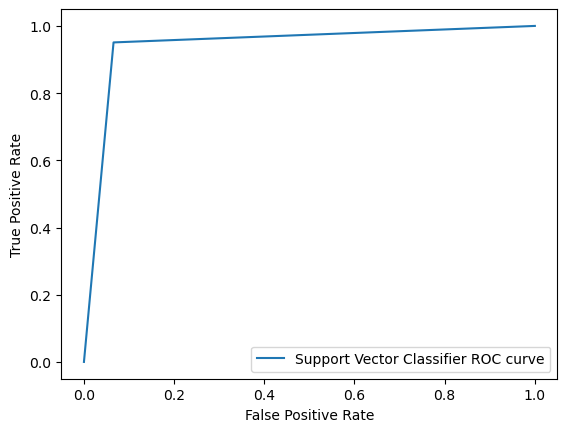

In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Read the cleaned_dataset.csv file
df_cleaned = pd.read_csv("cleaned_dataset.csv")

# Read the cleaned_dataset_unchanged_typeEncoded.csv file
df_unchanged = pd.read_csv("cleaned_dataset_unchanged_typeEncoded.csv")
df = df_cleaned.copy()

# Split the data into features (X) and target variable (y)
X = df.drop('isFraud', axis=1)
y = df['isFraud']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Model 1: Random Forest Classifier
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train_scaled, y_train)
rf_predictions = rf_model.predict(X_test_scaled)

# Model 2: Logistic Regression
lr_model = LogisticRegression(random_state=42)
lr_model.fit(X_train_scaled, y_train)
lr_predictions = lr_model.predict(X_test_scaled)

# Model 3: Support Vector Classifier (SVC)
svc_model = SVC(probability=True, random_state=42)
svc_model.fit(X_train_scaled, y_train)
svc_predictions = svc_model.predict(X_test_scaled)

# Function to print evaluation metrics
def print_metrics(y_true, y_pred, model_name):
    print(f"Metrics for {model_name}:")
    print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
    print(f"Confusion Matrix:\n{confusion_matrix(y_true, y_pred)}")
    print(f"Precision: {precision_score(y_true, y_pred)}")
    print(f"Recall: {recall_score(y_true, y_pred)}")
    print(f"F1 Score: {f1_score(y_true, y_pred)}")
    print(f"ROC AUC Score: {roc_auc_score(y_true, y_pred)}")
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    plt.plot(fpr, tpr, label=f'{model_name} ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.show()

# Print metrics for each model
print_metrics(y_test, rf_predictions, "Random Forest")
print_metrics(y_test, lr_predictions, "Logistic Regression")
print_metrics(y_test, svc_predictions, "Support Vector Classifier")


## Training without PCA + No Columns Dropped

Metrics for Random Forest:
Accuracy: 0.9865060240963855
Confusion Matrix:
[[1015   21]
 [   7 1032]]
Precision: 0.98005698005698
Recall: 0.9932627526467758
F1 Score: 0.9866156787762906
ROC AUC Score: 0.9864962411882526


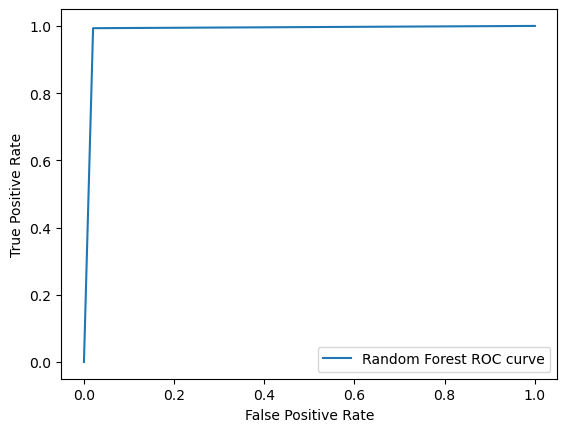

Metrics for Logistic Regression:
Accuracy: 0.9710843373493976
Confusion Matrix:
[[ 983   53]
 [   7 1032]]
Precision: 0.9511520737327189
Recall: 0.9932627526467758
F1 Score: 0.9717514124293786
ROC AUC Score: 0.9710522257442373


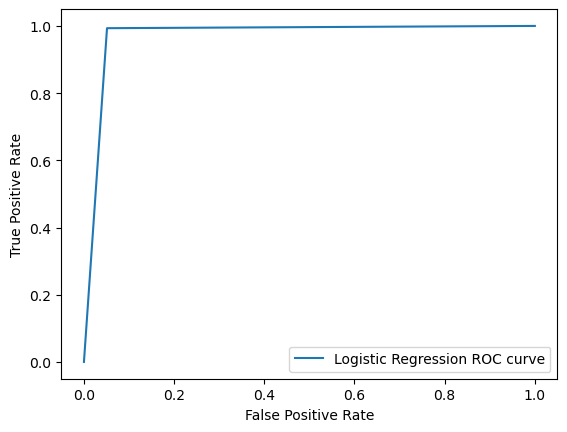

Metrics for Support Vector Classifier:
Accuracy: 0.9590361445783132
Confusion Matrix:
[[ 977   59]
 [  26 1013]]
Precision: 0.9449626865671642
Recall: 0.9749759384023099
F1 Score: 0.9597347228801516
ROC AUC Score: 0.9590130657262514


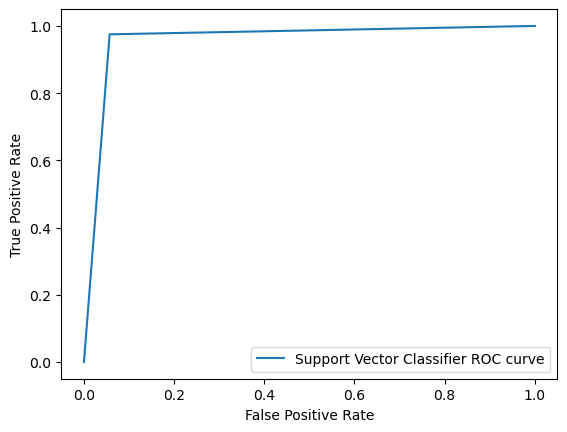

In [2]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt


# Read the cleaned_dataset_unchanged.csv file
df2 = pd.read_csv("cleaned_dataset_unchanged_typeEncoded.csv")

# Label encode 'nameOrig' and 'nameDest' columns
le = LabelEncoder()
df2['nameOrig'] = le.fit_transform(df2['nameOrig'])
df2['nameDest'] = le.fit_transform(df2['nameDest'])

# Split the data into features (X) and target variable (y)
X2 = df2.drop('isFraud', axis=1)
y2 = df2['isFraud']

# Split the data into training and testing sets
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

# Standardize the features
scaler2 = StandardScaler()
X2_train_scaled = scaler2.fit_transform(X2_train)
X2_test_scaled = scaler2.transform(X2_test)

# Model 1: Random Forest Classifier
rf_model2 = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model2.fit(X2_train_scaled, y2_train)
rf_predictions2 = rf_model2.predict(X2_test_scaled)

# Model 2: Logistic Regression
lr_model2 = LogisticRegression(random_state=42)
lr_model2.fit(X2_train_scaled, y2_train)
lr_predictions2 = lr_model2.predict(X2_test_scaled)

# Model 3: Support Vector Classifier (SVC)
svc_model2 = SVC(probability=True, random_state=42)
svc_model2.fit(X2_train_scaled, y2_train)
svc_predictions2 = svc_model2.predict(X2_test_scaled)

# Function to print evaluation metrics
def print_metrics(y_true, y_pred, model_name):
    print(f"Metrics for {model_name}:")
    print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
    print(f"Confusion Matrix:\n{confusion_matrix(y_true, y_pred)}")
    print(f"Precision: {precision_score(y_true, y_pred)}")
    print(f"Recall: {recall_score(y_true, y_pred)}")
    print(f"F1 Score: {f1_score(y_true, y_pred)}")
    print(f"ROC AUC Score: {roc_auc_score(y_true, y_pred)}")
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    plt.plot(fpr, tpr, label=f'{model_name} ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.show()

# Print metrics for each model
print_metrics(y2_test, rf_predictions2, "Random Forest")
print_metrics(y2_test, lr_predictions2, "Logistic Regression")
print_metrics(y2_test, svc_predictions2, "Support Vector Classifier")


## Training without PCA +  Columns (NameOrig+NameDest) Dropped

Metrics for Random Forest:
Accuracy: 0.9889156626506024
Confusion Matrix:
[[1020   16]
 [   7 1032]]
Precision: 0.9847328244274809
Recall: 0.9932627526467758
F1 Score: 0.9889793962625778
ROC AUC Score: 0.9889093686013801


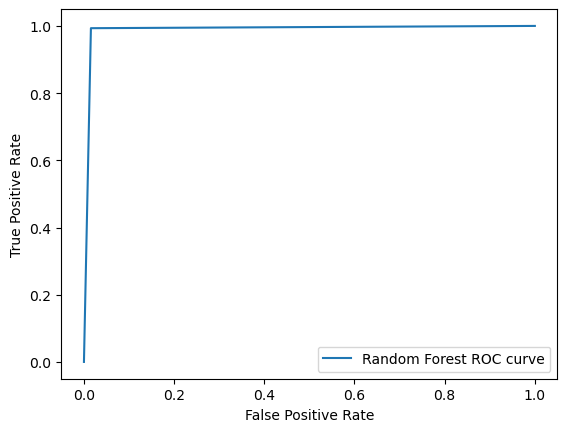

Metrics for Logistic Regression:
Accuracy: 0.971566265060241
Confusion Matrix:
[[ 984   52]
 [   7 1032]]
Precision: 0.9520295202952029
Recall: 0.9932627526467758
F1 Score: 0.9722091380122468
ROC AUC Score: 0.9715348512268627


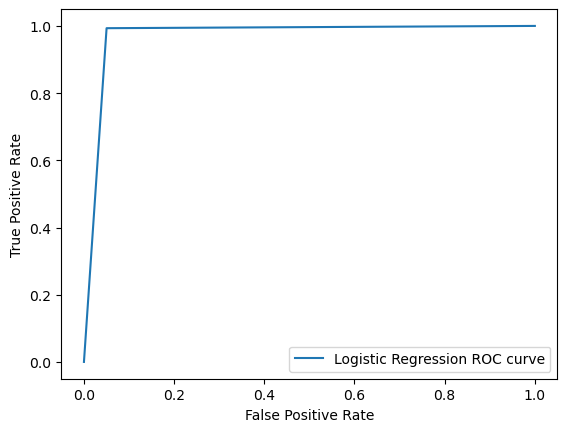

Metrics for Support Vector Classifier:
Accuracy: 0.9619277108433735
Confusion Matrix:
[[ 979   57]
 [  22 1017]]
Precision: 0.946927374301676
Recall: 0.9788257940327237
F1 Score: 0.9626123994320871
ROC AUC Score: 0.9619032445067093


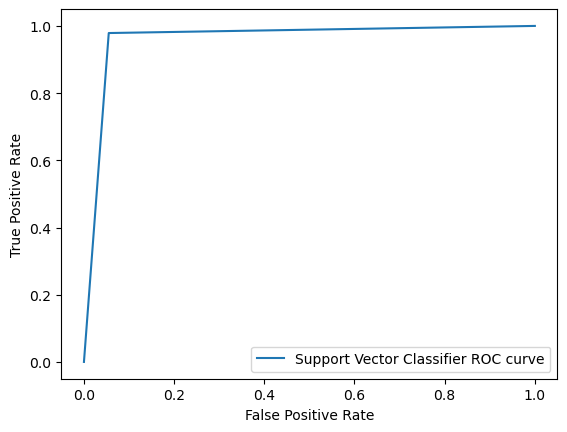

In [3]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt

# Read the cleaned_dataset_unchanged_typeEncoded.csv file
df2 = pd.read_csv("cleaned_dataset_unchanged_typeEncoded.csv")

# Drop 'nameOrig' and 'nameDest' columns
df2 = df2.drop(['nameOrig', 'nameDest'], axis=1)

# Split the data into features (X) and target variable (y)
X2 = df2.drop('isFraud', axis=1)
y2 = df2['isFraud']

# Split the data into training and testing sets
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

# Standardize the features
scaler2 = StandardScaler()
X2_train_scaled = scaler2.fit_transform(X2_train)
X2_test_scaled = scaler2.transform(X2_test)

# Model 1: Random Forest Classifier
rf_model2 = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model2.fit(X2_train_scaled, y2_train)
rf_predictions2 = rf_model2.predict(X2_test_scaled)

# Model 2: Logistic Regression
lr_model2 = LogisticRegression(random_state=42)
lr_model2.fit(X2_train_scaled, y2_train)
lr_predictions2 = lr_model2.predict(X2_test_scaled)

# Model 3: Support Vector Classifier (SVC)
svc_model2 = SVC(probability=True, random_state=42)
svc_model2.fit(X2_train_scaled, y2_train)
svc_predictions2 = svc_model2.predict(X2_test_scaled)

# Function to print evaluation metrics
def print_metrics(y_true, y_pred, model_name):
    print(f"Metrics for {model_name}:")
    print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
    print(f"Confusion Matrix:\n{confusion_matrix(y_true, y_pred)}")
    print(f"Precision: {precision_score(y_true, y_pred)}")
    print(f"Recall: {recall_score(y_true, y_pred)}")
    print(f"F1 Score: {f1_score(y_true, y_pred)}")
    print(f"ROC AUC Score: {roc_auc_score(y_true, y_pred)}")
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    plt.plot(fpr, tpr, label=f'{model_name} ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.show()


# Print metrics for each model
print_metrics(y2_test, rf_predictions2, "Random Forest")
print_metrics(y2_test, lr_predictions2, "Logistic Regression")
print_metrics(y2_test, svc_predictions2, "Support Vector Classifier")


## Based On Results: Dataset without PCA + Columns Dropped Selected 

## Model Improvement (Parameter hypertuning)

Metrics for Tuned Random Forest:
Accuracy: 0.9898795180722891
Confusion Matrix:
[[1021   15]
 [   6 1033]]
Precision: 0.9856870229007634
Recall: 0.9942252165543792
F1 Score: 0.9899377096310494
ROC AUC Score: 0.9898732260378074


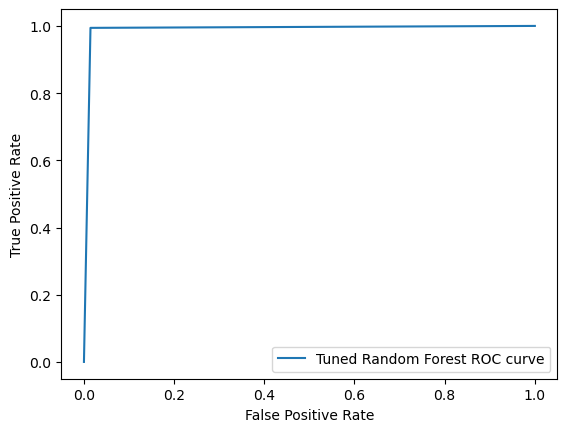

C:\Users\Huzaifa\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\Huzaifa\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_i

Metrics for Tuned Logistic Regression:
Accuracy: 0.9783132530120482
Confusion Matrix:
[[ 997   39]
 [   6 1033]]
Precision: 0.9636194029850746
Recall: 0.9942252165543792
F1 Score: 0.9786830885836096
ROC AUC Score: 0.9782902144547958


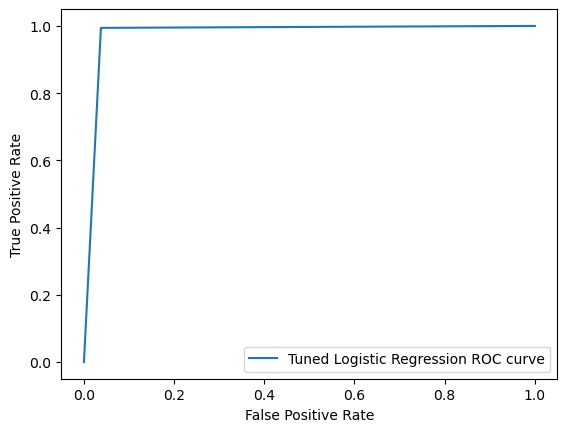

Metrics for Tuned Support Vector Classifier:
Accuracy: 0.9773493975903614
Confusion Matrix:
[[ 995   41]
 [   6 1033]]
Precision: 0.9618249534450651
Recall: 0.9942252165543792
F1 Score: 0.9777567439659252
ROC AUC Score: 0.9773249634895449


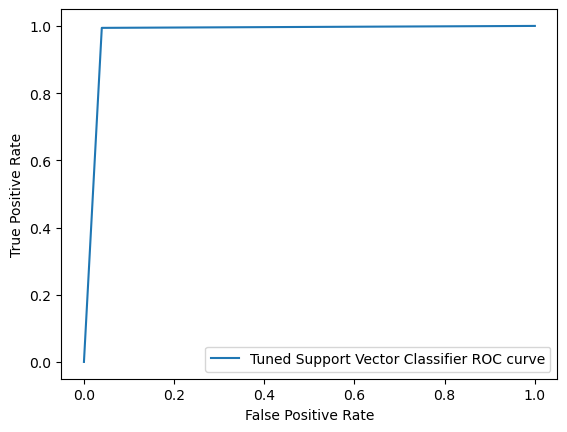

Metrics for Tuned Random Forest:
Accuracy: 0.9898795180722891
Confusion Matrix:
[[1021   15]
 [   6 1033]]
Precision: 0.9856870229007634
Recall: 0.9942252165543792
F1 Score: 0.9899377096310494
ROC AUC Score: 0.9898732260378074


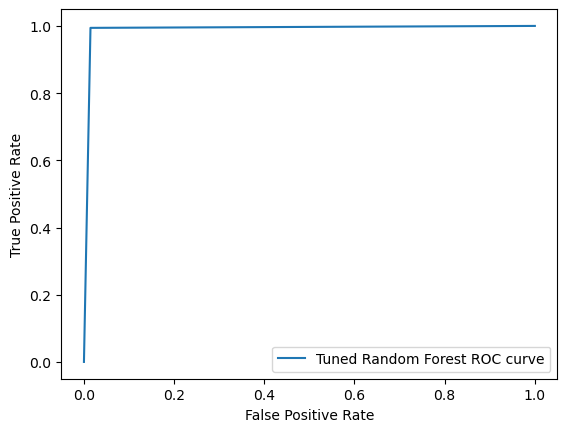

Metrics for Tuned Logistic Regression:
Accuracy: 0.9783132530120482
Confusion Matrix:
[[ 997   39]
 [   6 1033]]
Precision: 0.9636194029850746
Recall: 0.9942252165543792
F1 Score: 0.9786830885836096
ROC AUC Score: 0.9782902144547958


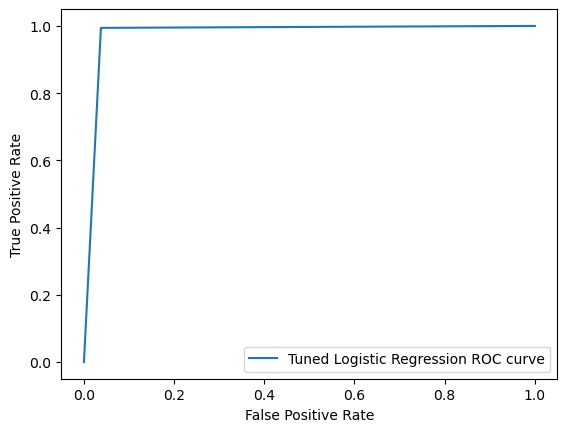

Metrics for Tuned Support Vector Classifier:
Accuracy: 0.9773493975903614
Confusion Matrix:
[[ 995   41]
 [   6 1033]]
Precision: 0.9618249534450651
Recall: 0.9942252165543792
F1 Score: 0.9777567439659252
ROC AUC Score: 0.9773249634895449


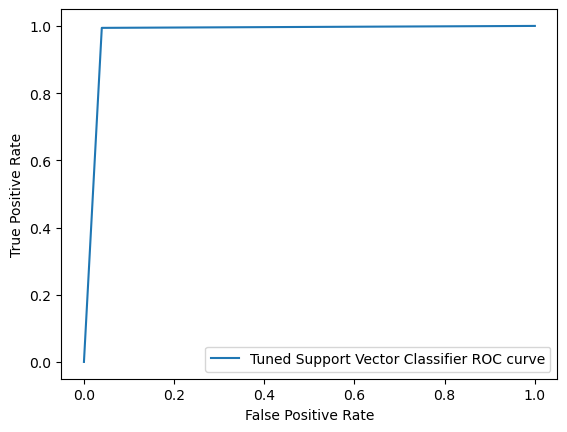

The best model based on overall performance is: Random Forest


In [5]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import joblib
import matplotlib.pyplot as plt


# Read the cleaned_dataset_unchanged.csv file
df2 = pd.read_csv("cleaned_dataset_unchanged_typeEncoded.csv")

# Drop 'nameOrig' and 'nameDest' columns
df2 = df2.drop(['nameOrig', 'nameDest'], axis=1)

# Split the data into features (X) and target variable (y)
X2 = df2.drop('isFraud', axis=1)
y2 = df2['isFraud']

# Split the data into training and testing sets
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

# Standardize the features
scaler2 = StandardScaler()
X2_train_scaled = scaler2.fit_transform(X2_train)
X2_test_scaled = scaler2.transform(X2_test)

# Function to print evaluation metrics
def print_metrics(y_true, y_pred, model_name):
    print(f"Metrics for {model_name}:")
    print(f"Accuracy: {accuracy_score(y_true, y_pred)}")
    print(f"Confusion Matrix:\n{confusion_matrix(y_true, y_pred)}")
    print(f"Precision: {precision_score(y_true, y_pred)}")
    print(f"Recall: {recall_score(y_true, y_pred)}")
    print(f"F1 Score: {f1_score(y_true, y_pred)}")
    print(f"ROC AUC Score: {roc_auc_score(y_true, y_pred)}")
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    plt.plot(fpr, tpr, label=f'{model_name} ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.show()


#Hypertuning And Evaluating the Selected Models
from sklearn.model_selection import GridSearchCV

# Model 1: Random Forest Classifier
param_grid_rf = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search_rf = GridSearchCV(RandomForestClassifier(random_state=42), param_grid_rf, cv=5, scoring='roc_auc')
grid_search_rf.fit(X2_train_scaled, y2_train)

# Get the best hyperparameters
best_params_rf = grid_search_rf.best_params_

# Train the model with the best hyperparameters
rf_model2_tuned = RandomForestClassifier(random_state=42, **best_params_rf)
rf_model2_tuned.fit(X2_train_scaled, y2_train)
rf_predictions2_tuned = rf_model2_tuned.predict(X2_test_scaled)

# Print metrics for the tuned Random Forest model
print_metrics(y2_test, rf_predictions2_tuned, "Tuned Random Forest")

# Model 2: Logistic Regression
param_grid_lr = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'penalty': ['l1', 'l2']
}

grid_search_lr = GridSearchCV(LogisticRegression(random_state=42), param_grid_lr, cv=5, scoring='roc_auc')
grid_search_lr.fit(X2_train_scaled, y2_train)

# Get the best hyperparameters
best_params_lr = grid_search_lr.best_params_

# Train the model with the best hyperparameters
lr_model2_tuned = LogisticRegression(random_state=42, **best_params_lr)
lr_model2_tuned.fit(X2_train_scaled, y2_train)
lr_predictions2_tuned = lr_model2_tuned.predict(X2_test_scaled)

# Print metrics for the tuned Logistic Regression model
print_metrics(y2_test, lr_predictions2_tuned, "Tuned Logistic Regression")

# Model 3: Support Vector Classifier (SVC)
param_grid_svc = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'rbf'],
    'gamma': ['scale', 'auto']
}

grid_search_svc = GridSearchCV(SVC(probability=True, random_state=42), param_grid_svc, cv=5, scoring='roc_auc')
grid_search_svc.fit(X2_train_scaled, y2_train)

# Get the best hyperparameters
best_params_svc = grid_search_svc.best_params_

# Train the model with the best hyperparameters
svc_model2_tuned = SVC(probability=True, random_state=42, **best_params_svc)
svc_model2_tuned.fit(X2_train_scaled, y2_train)
svc_predictions2_tuned = svc_model2_tuned.predict(X2_test_scaled)

# Print metrics for the tuned Support Vector Classifier model
print_metrics(y2_test, svc_predictions2_tuned, "Tuned Support Vector Classifier")


#----------------------------------MODEL SELECTION-------------------------------------

def evaluate_model(y_true, y_pred, model_name):
    accuracy = accuracy_score(y_true, y_pred)
    confusion_mat = confusion_matrix(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)
    roc_auc = roc_auc_score(y_true, y_pred)

    print(f"Metrics for {model_name}:")
    print(f"Accuracy: {accuracy}")
    print(f"Confusion Matrix:\n{confusion_mat}")
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    print(f"F1 Score: {f1}")
    print(f"ROC AUC Score: {roc_auc}")

    # Plot ROC curve
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    plt.plot(fpr, tpr, label=f'{model_name} ROC curve')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.show()

    return {
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1 Score": f1,
        "ROC AUC": roc_auc
    }


# Evaluate the models
rf_metrics = evaluate_model(y2_test, rf_predictions2_tuned, "Tuned Random Forest")
lr_metrics = evaluate_model(y2_test, lr_predictions2_tuned, "Tuned Logistic Regression")
svc_metrics = evaluate_model(y2_test, svc_predictions2_tuned, "Tuned Support Vector Classifier")

# Compare models based on multiple metrics
models_metrics = {
    "Random Forest": rf_metrics,
    "Logistic Regression": lr_metrics,
    "Support Vector Classifier": svc_metrics
}

# Choose the model with the best average performance across metrics
best_model = max(models_metrics, key=lambda k: sum(models_metrics[k].values()) / len(models_metrics[k]))

print(f"The best model based on overall performance is: {best_model}")

# Save the best model using joblib
if best_model == "Random Forest":
    joblib.dump(rf_model2_tuned, 'best_model.joblib')
elif best_model == "Logistic Regression":
    joblib.dump(lr_model2_tuned, 'best_model.joblib')
elif best_model == "Support Vector Classifier":
    joblib.dump(svc_model2_tuned, 'best_model.joblib')

## Model Selected: Random Forest